In [54]:
import sentencepiece as spm
from tqdm import tqdm
import pandas as pd
import numpy as np
import seaborn as sns
import scipy.stats as sps
import nlp
import random

from sklearn.model_selection import train_test_split

import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
from torch.utils.data import DataLoader
from torch.utils.tensorboard import SummaryWriter

from src.seq2seq_generator import Seq2Seq, Encoder, Decoder
from src.cnn_discriminator import CNNDiscriminator
from src.utils import *
from src.dataset import Dataset, Padder

import gensim.corpora as corpora
from gensim.utils import simple_preprocess
from gensim.models import CoherenceModel
from rouge_score import rouge_scorer
from sklearn.manifold import TSNE
import matplotlib.colors as mcolors

sns.set_style('whitegrid')

### 0. Data

In [2]:
dataset_name = 'news'

In [3]:
%%time

if dataset_name == 'cnn':
    train_dataset = nlp.load_dataset("cnn_dailymail", "3.0.0", split="train")
    val_dataset = nlp.load_dataset("cnn_dailymail", "3.0.0", split="validation")
    test_dataset = nlp.load_dataset("cnn_dailymail", "3.0.0", split="test")
    train_articles = [item['article'] for item in train_dataset]
    train_highlights = [item['highlights'] for item in train_dataset]
    val_articles = [item['article'] for item in val_dataset]
    val_highlights = [item['highlights'] for item in val_dataset]
elif dataset_name == 'news':
    news = pd.read_csv('data/news_summary.csv')
    news.headlines = [process_str(s) for s in news.headlines]
    news.text = [process_str(s) for s in news.text]
    X_train, X_test = train_test_split(news, test_size=0.3,
                                       random_state=42)
    train_articles = X_train.text.values
    train_highlights = X_train.headlines.values
    val_articles = X_test.text.values
    val_highlights = X_test.headlines.values

CPU times: user 717 ms, sys: 36 ms, total: 753 ms
Wall time: 753 ms


In [4]:
train_new_model = False

In [5]:
%%time
if train_new_model:
    with open('data/news_texts.txt', 'a') as f:
        for article in tqdm(train_articles):
            f.write(article + '\n')
        for highlight in tqdm(train_highlights):
            f.write(highlight + '\n')
        for article in tqdm(val_articles):
            f.write(article + '\n')
        for highlight in tqdm(val_highlights):
            f.write(highlight + '\n')
            
    spm.SentencePieceTrainer.train(input='data/news_texts.txt',
                                   model_prefix='news10k',
                                   vocab_size=10000,
                                   pad_id=0,
                                   bos_id=1,
                                   eos_id=2,
                                   unk_id=3)

CPU times: user 2 µs, sys: 0 ns, total: 2 µs
Wall time: 2.62 µs


### 1. lda

In [6]:
bigram = False
lemmas = False
train_model = False
modelname = f'topic_models/news_train_bigram{bigram}_lemmas{lemmas}.model'

In [7]:
%%time

articles_train_words = process_texts(train_articles, bigram=bigram, lemmas=lemmas)
highlights_train_words = process_texts(train_highlights, bigram=bigram, lemmas=lemmas)

articles_val_words = process_texts(val_articles, bigram=bigram, lemmas=lemmas)
highlights_val_words = process_texts(val_highlights, bigram=bigram, lemmas=lemmas)

id2word = corpora.Dictionary(articles_train_words)

articles_train_corpus = [id2word.doc2bow(text) for text in articles_train_words]
highlights_train_corpus = [id2word.doc2bow(text) for text in highlights_train_words]

articles_val_corpus = [id2word.doc2bow(text) for text in articles_val_words]
highlights_val_corpus = [id2word.doc2bow(text) for text in highlights_val_words]

CPU times: user 26.7 s, sys: 239 ms, total: 26.9 s
Wall time: 26.9 s


In [8]:
%%time
if train_model:
    lda_model = gensim.models.ldamodel.LdaModel(corpus=articles_train_corpus,
                                                id2word=id2word,
                                                num_topics=10, 
                                                random_state=100,
                                                update_every=1,
                                                chunksize=100,
                                                passes=10,
                                                alpha='auto',
                                                per_word_topics=True)
    lda_model.save(modelname)
else:
    lda_model = gensim.models.ldamodel.LdaModel.load(modelname)

lda_model.print_topics()

CPU times: user 25.4 ms, sys: 8.01 ms, total: 33.4 ms
Wall time: 32.4 ms


[(0,
  '0.031*"based" + 0.026*"million" + 0.020*"used" + 0.018*"startup" + 0.014*"using" + 0.013*"deal" + 0.012*"public" + 0.011*"worth" + 0.011*"months" + 0.010*"making"'),
 (1,
  '0.030*"khan" + 0.029*"tweeted" + 0.022*"air" + 0.020*"part" + 0.015*"elections" + 0.015*"shah" + 0.015*"upcoming" + 0.015*"user" + 0.014*"flight" + 0.013*"show"'),
 (2,
  '0.028*"india" + 0.022*"also" + 0.018*"years" + 0.013*"accused" + 0.011*"national" + 0.011*"arrested" + 0.011*"actress" + 0.010*"revealed" + 0.010*"leader" + 0.009*"according"'),
 (3,
  '0.081*"said" + 0.033*"added" + 0.019*"film" + 0.011*"would" + 0.010*"like" + 0.009*"actor" + 0.009*"singh" + 0.008*"people" + 0.007*"wrote" + 0.006*"media"'),
 (4,
  '0.063*"us" + 0.040*"president" + 0.024*"modi" + 0.023*"country" + 0.023*"pm" + 0.021*"trump" + 0.017*"pakistan" + 0.015*"narendra" + 0.013*"donald" + 0.011*"house"'),
 (5,
  '0.024*"china" + 0.022*"security" + 0.019*"car" + 0.015*"series" + 0.015*"led" + 0.015*"states" + 0.014*"away" + 0.014*

In [9]:
coherence_model_lda = CoherenceModel(model=lda_model,
                                     texts=articles_train_words,
                                     dictionary=id2word,
                                     coherence='c_v')
coherence_lda = coherence_model_lda.get_coherence()
print('Coherence Score: ', coherence_lda)

Coherence Score:  0.38893017640073324


### 2. Default metrics

In [10]:
articles_train_topics = [get_topic_vector(lda_model, text) for text in articles_train_corpus]
articles_train_ohe = [get_ohe_topic_vector(lda_model, text) for text in articles_train_corpus]
highlights_train_topics = [get_topic_vector(lda_model, text) for text in highlights_train_corpus]
highlights_train_ohe = [get_ohe_topic_vector(lda_model, text) for text in highlights_train_corpus]

articles_val_topics = [get_topic_vector(lda_model, text) for text in articles_val_corpus]
articles_val_ohe = [get_ohe_topic_vector(lda_model, text) for text in articles_val_corpus]
highlights_val_topics = [get_topic_vector(lda_model, text) for text in highlights_val_corpus]
highlights_val_ohe = [get_ohe_topic_vector(lda_model, text) for text in highlights_val_corpus]

cosines: mean 0.917, std 0.049
euclidean distances: mean 0.16, std 0.051


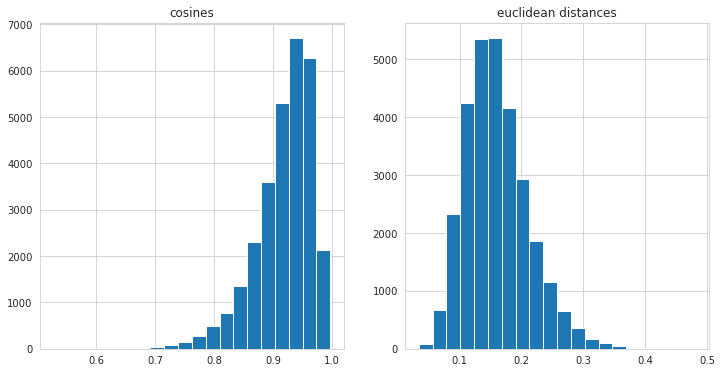

In [11]:
eucl, cosines = plot_distances(articles_val_topics, highlights_val_topics,
                               return_results=True)

In [ ]:
# np.save('cosines_default.npy', cosines)
# np.save('eucl_default.npy', eucl)

### 3. Model metrics

In [ ]:
vocab_size = 10000
sp_modelname = f'sentencepiece_models/news{int(vocab_size/1000)}k.model'
sp = spm.SentencePieceProcessor(model_file=sp_modelname)

In [ ]:
train_dataset = Dataset(train_articles, train_highlights, sp=sp)
val_dataset = Dataset(val_articles, val_highlights, sp=sp)

train_dataloader = DataLoader(train_dataset, batch_size=128,
                              collate_fn=Padder(), shuffle=True)
val_dataloader = DataLoader(val_dataset, batch_size=128,
                            collate_fn=Padder(), shuffle=False)

In [ ]:
device = 'cpu'
print(device)

In [ ]:
INPUT_DIM = vocab_size
OUTPUT_DIM = vocab_size
ENC_EMB_DIM = 256
DEC_EMB_DIM = 256
HID_DIM = 256
N_LAYERS = 3
ENC_DROPOUT = 0.1
DEC_DROPOUT = 0.1

enc = Encoder(INPUT_DIM, ENC_EMB_DIM, HID_DIM, N_LAYERS, ENC_DROPOUT)
dec = Decoder(OUTPUT_DIM, DEC_EMB_DIM, HID_DIM, N_LAYERS, DEC_DROPOUT)

G = Seq2Seq(enc, dec, device).to(device)
save_path = 'saved_models/gen_adv.pth'
G.load_state_dict(torch.load(save_path))

In [23]:
%%time

'''
predicted_train = []
for i, batch in tqdm(enumerate(train_dataloader)):
    article = batch[0].to(device)
    highlight = batch[1].to(device)
    preds = G.sample(article, highlight, teacher_forcing_ratio=0.)[1]
    predicted_train += tensor_to_text(preds, sp)
'''
    
predicted_val = []
for i, batch in tqdm(enumerate(val_dataloader)):
    article = batch[0].to(device)
    highlight = batch[1].to(device)
    preds = G.sample(article, highlight, teacher_forcing_ratio=0.)[1]
    predicted_val += tensor_to_text(preds, sp)
    
'''
predicted_train_words = process_texts(predicted_train, bigram=bigram, lemmas=lemmas)
predicted_train_corpus = [id2word.doc2bow(text) for text in predicted_train_words]
predicted_train_topics = [get_topic_vector(lda_model, text) for text in predicted_train_corpus]
predicted_train_ohe = [get_ohe_topic_vector(lda_model, text) for text in predicted_train_corpus]
'''

predicted_val_words = process_texts(predicted_val, bigram=bigram, lemmas=lemmas)
predicted_val_corpus = [id2word.doc2bow(text) for text in predicted_val_words]
predicted_val_topics = [get_topic_vector(lda_model, text) for text in predicted_val_corpus]
predicted_val_ohe = [get_ohe_topic_vector(lda_model, text) for text in predicted_val_corpus]

231it [01:58,  1.95it/s]


CPU times: user 15min 47s, sys: 9.62 s, total: 15min 57s
Wall time: 2min 5s


In [24]:
a = [1., 0., 0., 0., 0., 0., 0., 0., 0., 0.]
articles_val_topics = [a for i in range(len(articles_val_topics))]

cosines: mean 0.173, std 0.096
euclidean distances: mean 1.005, std 0.038


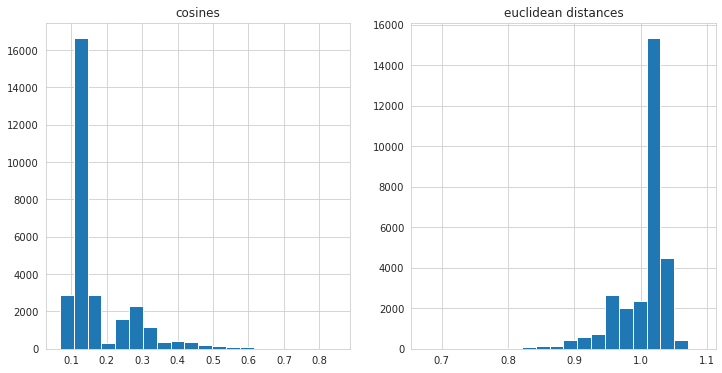

In [25]:
eucl, cosines = plot_distances(articles_val_topics, predicted_val_topics, 
                               return_results=True)

In [27]:
'''
np.save('preds_gen_adv_onehot.npy', np.array(predicted_val_words))
np.save('cosines_gen_adv_onehot.npy', cosines)
np.save('eucl_gen_adv_onehot.npy', eucl)
'''

"\nnp.save('preds_gen_adv_onehot.npy', np.array(predicted_val_words))\nnp.save('cosines_gen_adv_onehot.npy', cosines)\nnp.save('eucl_gen_adv_onehot.npy', eucl)\n"

### 4. Models  metric comparison

In [28]:
def compare_metrics(arr1, arr2, title):
    s, pvalue = sps.mannwhitneyu(arr1, arr2)
    pvalue = np.round(pvalue, 3)
    print(f'pvalue: {pvalue}')

    label1 = f'topic_adv, mean {np.round(np.mean(arr1), 3)}, std {np.round(np.std(arr1), 3)}'
    label2 = f'gen_adv, mean {np.round(np.mean(arr2), 3)}, std {np.round(np.std(arr2), 3)}'

    plt.figure(figsize=(12, 6))

    plt.title('cosines')
    plt.hist(arr1, bins=20, alpha=0.5, density=True, label=label1)
    plt.hist(arr2, bins=20, alpha=0.5, density=True, label=label2) 
    plt.legend()
    plt.show()

In [31]:
cosines1 = np.load('cosines_gen_topic_exact.npy')
cosines2 = np.load('cosines_gen_adv_onehot.npy')
eucl1 = np.load('eucl_gen_topic_exact.npy')
eucl2 = np.load('eucl_gen_adv_onehot.npy') 

pvalue: 0.0


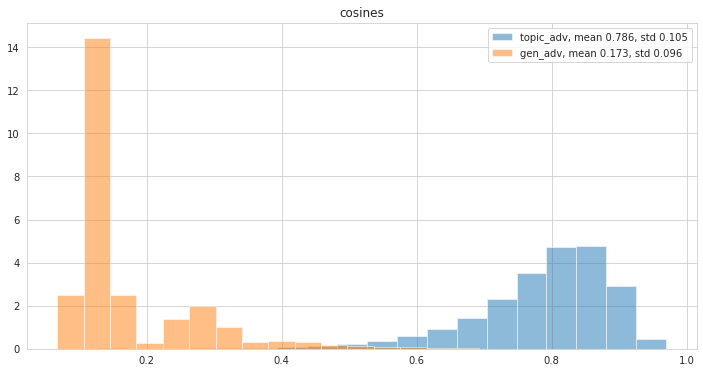

In [32]:
compare_metrics(cosines1, cosines2, 'cosines')

pvalue: 0.0


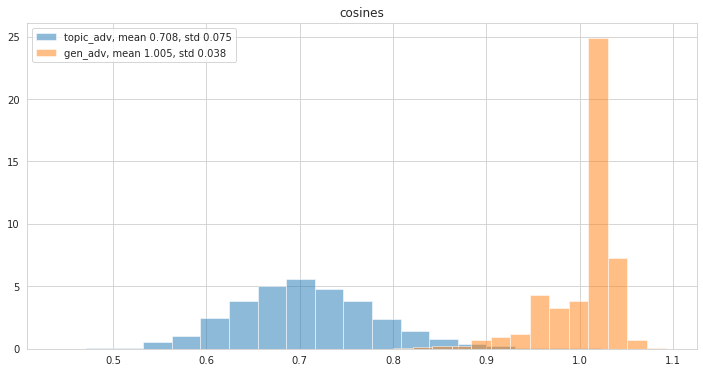

In [33]:
compare_metrics(eucl1, eucl2, 'eucl_dists')

### 5. Model predictions comparison

In [12]:
train_dataset = Dataset(train_articles, train_highlights, sp=sp)
val_dataset = Dataset(val_articles, val_highlights, sp=sp)

train_dataloader = DataLoader(train_dataset, batch_size=128,
                              collate_fn=Padder(), shuffle=True)
val_dataloader = DataLoader(val_dataset, batch_size=128,
                            collate_fn=Padder(), shuffle=False)

In [11]:
vocab_size = 10000
INPUT_DIM = vocab_size
OUTPUT_DIM = vocab_size
ENC_EMB_DIM = 256
DEC_EMB_DIM = 256
HID_DIM = 256
N_LAYERS = 3
ENC_DROPOUT = 0.1
DEC_DROPOUT = 0.1

enc = Encoder(INPUT_DIM, ENC_EMB_DIM, HID_DIM, N_LAYERS, ENC_DROPOUT)
dec = Decoder(OUTPUT_DIM, DEC_EMB_DIM, HID_DIM, N_LAYERS, DEC_DROPOUT)

device = 'cpu'
print(device)

G = Seq2Seq(enc, dec, device).to(device)
save_path = 'saved_models/gen_adv.pth'
G.load_state_dict(torch.load(save_path))

vocab_size = 10000
sp_modelname = f'sentencepiece_models/news{int(vocab_size/1000)}k.model'
sp = spm.SentencePieceProcessor(model_file=sp_modelname)

cpu


In [13]:
predicted_val = []
for i, batch in tqdm(enumerate(val_dataloader)):
    article = batch[0].to(device)
    highlight = batch[1].to(device)
    preds = G.sample(article, highlight, teacher_forcing_ratio=0.)[1]
    predicted_val += tensor_to_text(preds, sp)
    break
    
predicted_val_words = process_texts(predicted_val, bigram=bigram, lemmas=lemmas)
predicted_val_corpus = [id2word.doc2bow(text) for text in predicted_val_words]
predicted_val_topics = [get_topic_vector(lda_model, text) for text in predicted_val_corpus]
predicted_val_ohe = [get_ohe_topic_vector(lda_model, text) for text in predicted_val_corpus]

0it [00:00, ?it/s]


ValueError: too many values to unpack (expected 3)

In [15]:
def preds_to_texts(preds):
    texts = []
    for pred in preds:
        texts.append(' '.join(pred))
        
    return texts

In [19]:
predicted_val_texts = preds_to_texts(predicted_val_words)
truth_val_texts = preds_to_texts(highlights_val_words)

In [24]:
G

Seq2Seq(
  (encoder): Encoder(
    (embedding): Embedding(10000, 256)
    (rnn): LSTM(256, 256, num_layers=3, dropout=0.1)
    (dropout): Dropout(p=0.1, inplace=False)
  )
  (decoder): Decoder(
    (embedding): Embedding(10000, 256)
    (rnn): LSTM(256, 256, num_layers=3, dropout=0.1)
    (out): Linear(in_features=512, out_features=10000, bias=True)
    (w): Linear(in_features=256, out_features=256, bias=True)
    (attn_lin): Linear(in_features=512, out_features=512, bias=True)
    (dropout): Dropout(p=0.1, inplace=False)
  )
)

In [23]:
for pred, truth in zip(predicted_val_texts, truth_val_texts):
    print(pred)
    print(truth)
    print()

students fail five proposal equals choose five
taka students get extra marks parents vote polls

syrian shooting intercepting missiles syrian air idlitan syria
syria shoots missiles fired two air bases

coollight scare new bodie prade
dinosaur like animal fossil found uttarakhand

uttar form upikf tom supports swachhs dalt board
may merge shia sunni waqf boards prevent fund wastage

activists get house term rapeingings online
egypt actress gets yrs jail fake news sexual harassment

last besting bezos bn equal prime investor
jeff bezos added wealth gdp nations

india zimbabwe tested hit cricket
bangladeshi captain mortaza announces retirement

clintm launches us offrom mexico source south drug aidesbra
mexican drug lord el chapo questions us extradition legality

un blames korea supplying ball test test korea missiles
korea supplies ballistic missiles myanmar un monitors

harbhajan merger krishss tweet user
thenga mila hamme harbhajan responds home buyers

force forces needed regimeer d


people saying ecpoints cm west prade mamata
ec must call party meet evms tampering issue mamata

mamata chief chief blames strike las violencece
mamata banerjee blames centre communal riots basirhat

afghan taliban gun dog used bid toi killed
afghan hostage steals gun shoots taliban captors escape

country dis diouriation yrs dec orr
extreme weather claimed lives government

hrs dominoed foodsed worth worth
robot lawyer saves clients crore parking ticket fines

google may allow user sing tracky replacement iphone
google may allow sharing battery status using maps

researcher explains hows typeing hair admitting alive study
hatred sound called misophonia genuine problem study

people displaced stuck sember since held
swine flu claims lives rajasthan

pm led minister minister sen prevent harm judges hc
pm modi talks law minister sc controversy reports

centre approves lakh house urban states project cr house
centre approves building lakh houses urban poor

hindu temple bjpsaededed paint

sl end odi losing streak wicket win india

uber co founder first eastchang pitch prod toss
uber co founder shares first plan pitched investors

deepika speaks deepikarfan us says himed
video deepika ranveer us vacation surfaces online

added delhi hai role actoroj
wanted kejriwal look sarkar character bajpayee

new uomato customer zomato toes boxes phone
zomato delivery man eats boxes repackages video viral

would compised bring newly guv governor
heard centre form sajad lone govt guv

made app madet us rathorers snapchating film row
made terrible mistake snapchat ad asking slap rihanna

gates gates gatess health protection bias national days
bill gates praises ayushman bharat scheme congratulates pm modi

fb bans ads displaying ads anlyies extremisez ads
facebook bans ads promoting

maha farmers allows water fund fund poll fund
maha allows mlas development funds work

brazil world expensive brand brand tn million petition cr
neymar becomes world expensive footballer crore

manipur fly

goa assembly issues guidelines accreditation media

farmering called know money bihar
amount money corrupt nitish srijan scam

bill special calling onself new york radio home
bill gates make special appearance big bang theory

trump denies using fake newss due lose tax tax
trump claim irish corporate tax cut fake news irish pm

quit coo coos oia twice founderbatra
raids co founders prannoy roy wife witch hunt ndtv

channel askss order tost ban anti anthem event conference
abvp seeks action national anthem insult jammu varsity

pandya step low sachin moreing securetial bjp
congress social media head cites jadhav action troll bjp

worldm declare day climate celebrated unesco unsumption
world tourism day celebrated september

apple ios features veivesopsst time
apple introduces ios iphones ipads

australian cricketer calls south africa de ab villiers
gilchrist calls south africa de kock superstar

election commissions date states voting states assembly
election commission announces poll d

gs student missing streets california evacuated
students kochi school evacuated ammonia leak

iaf officer security informed false punjabi pakistan report
iaf officer detained leaking info pak via whatsapp

ayushmann shares wife hisfrom direct sanju debut makers
st step towards dream ayushmann wife directorial debut

taka karnatak fail student flagg wred sandship
karnataka mla tries burn self argument police

assam assam raland sorm song name city kabhiuka
assam govt removes communist singer festival video

pakb wanted nation bsf official concern
pak want india peaceful atmosphere bsf

plasticsd ing sivitiesed key mallya
united spirits books fixed post takeover mallya diageo

release two members boys playing xi
army sends back boys pok crossed loc mistake

twitterka banleall ke ai emojis madameland twitter tweets tweets song
defeat evil tweets user strawberry pizza

tesla lockly probe auto tesla death years dept
tesla autopilot lacked safeguards us traffic safety board

position sentenc

man posts touch army women signs working
man gropes women shares videos social media

pnb puts renb crore gives crore crore fraud
pnb get crore recap share amid fraud case report

friends tiger tiger sh kapoor starring dutt march
release date hrithik tiger vaani starrer film announced

acting like like ball game gran tis kalki
acting like game badminton pankaj tripathi

year old indian female parave kaur becomes national anthem
rahi sarnobat st indian female shooter win asiad gold

mobile mobile additionals produced india govt
mobile phones worth cr produced india

itsed build political object diing irani
kerala may reclaim land actor multiplex built

republic bangladesh celebrated independence year rama day
january celebrated independence day years

killed border explodes pakistan
sikhs among killed bomb blast pakistan

improving entertainment bepossible becomeing rana
adjusting new role big deal new sbi chief

us commit missions scares irma
us cops warn people shoot guns hurricane ir


man sues iphone waitn iphone iphone bmw driving
hyderabad lawyer sues apple selling defective iphone

bsingmic dinosaurs found dinosaurn pic old fossil
ticks fed dinosaur blood mn year old fossil reveals

china lead nuclear weapon china
china draws gas flammable ice south china sea

citizens moreite themse women us docs
canada allow gender neutral passports

govt approves possession food pan pact minister
centre draft policy proposes abolishing haj subsidy

fun solved like rolld get windbreake
mit students strengthen concrete adding recycled plastic

softbank valu raises bn billion valuation firm
softbank invests billion korea commerce firm coupang

kohli rapes pacer hits tea whilei test
enjoy occasion score many runs kohli eng debutant

may reveal upt create alia nude turn
maybe shut janhvi media misquoting

polio pharma fundings lakhl steal us us
aurobindo recalls lakh bottles bp lowering drug us

flights last taxi air flights flight delay
air india flyers protest flight delayed hou

sense humour teamwork essential mars astronaut study

ship begins day day fire drill militar korea
china navy begins live fire drill near north korea

startupwork raises round us raise global funding abank
co working space startup wework hits billion valuation

world smallest eatery istuck nights ice
world smallest restaurant seats per person

flight flyers moved black remove black
ba flight cancelled bird found flapping around cockpit

twitter suffers facial outage one outage
youtube suffers global outage company issues apology

delhi delhi mins tried unfidenes targety trading
lenskart charges dnd users unsubscribe spam smses

cong supporter pairs rahul bjp confession
rajiv gandhi father mob lynching bjp leader puts posters

delhi hc issuess deny govt pil action fir
delhi govt gets hc notice illegal pathological labs

cia removes details unifiing vopal used linked
wikileaks releases files showing mass surveillance russia

ex apple coo kr slam slams magazine overexist atss
ex apple eng

controversial trump statements last year

months fored ramkula rahim convicted yoga
eight dera followers arrested attacking fuel station

ravat nott like welcome india mishr mishr
romeo juliet welcome delhi aap minister

bcci names ex appointed pacerari md ex khan
icc names ex air asia cfo ankur khanna cfo

ronaldo gets hands teens bicycle bicycle cl kick againfrom
ronaldo nets bicycle kick goal opposition fans applaud

tudhya teaching tdp saram attack
masjids madrasas teaching real islam bjp leader

ied pic withabout kaif onabout priyanka
troll commented going nowhere like dog priyanka

wood wedding mark pic kylif spie mart vogue
vogue shares snapchat ceo miranda kerr wedding pic

huge crush sanjayaaa
huge crush dutt posters room raveena

google investor ola mn stake reports report
benchmark sell uber stock million report

retts red indialdesk
free international calls vodafone red postpaid

watched south mexicanlyliye jokeon
yaaron ka koi thikana nahi hota jonty insta pic location

co

ndtv tryingingle misad medias government govt dept
ndtv misleading media public crore penalty govt

smart zealand website feeds selfies users inan uk
airline plans trips based users facial expressions

win says amit shah chief
india run men opp unite rahul

jacque pictures star anurag anurag director report report
dangal actress sanya star kashyap next film report

child health visiblation actor
admired since childhood dharmendra shashi demise

csk congratulates shane old younge hit century takes hit century
csk laud watson becomes oldest player score bbl ton

world go pamis land ed withfrom german car
player produces look shot baseline win point

magazine redage due comed comedy china
china cuts live awards coverage independent taiwan speech

shkreli shks ceo killing jail term money years
martin shkreli gets yrs prison defrauding investors

sonam kapoor deepika dances bema khushilia mehen mehen
sonam mom sunita dance london thumakda mehendi function

srk calls strong stallies fake new

bjp using militants gain power tripura cm sarkar

yes rbi sugaresha resigns rd top bank board board board
yes bank director quits says unhappy developments

dhoni dhoni record record stumpings ipl
ms dhoni sets record stumpings ipl

railway railway coaches man small performs auto
minister shares video women performing garba train

bumrahs celebrates miss miss dream turns met
fifer cherish forever bumrah poses next honour board

india agree need work together india china
india us agree work together india nsg membership

ec bengalursh rajasthan pollss polls polls
elections states may held ls polls report

man hanging div months dead alive beach
woman swept away months ago found alive beach

taka man held half lakhed ing posted
man cheats year old grandfather lakh arrested

ravindra jadeir fitness aap ashwin india classic april reports
bcci upgrades jadeja pujara grade contracts

isilamic state kills quakes kurdis kurdis town syria
isis kills prisoners syria report

delhi file petition f


drunk drunked toilip indian kiss harass kiss cyrus allegations
queen director got drunk forcibly tried kiss actress

game thrones rock game ly highest got watch
game thrones episode watched tv despite leak

corruption bill educated death mediahood media
private members bills introduced lok sabha

maldives border statue statue statueed anti anti nations
maldives destroys statues deemed anti islamic

inflation minute ends hours fails report childs
us prez trump watches tv hours daily reports

air india arrested kg foringing food flight
ai crew member arrested smuggling kg ganja meal cart

govt proposes build statue statueifyst ram ayodhya
govt proposes build lord ram statue ayodhya

votes yr votes sinces affect changes
bjp needed total votes seats form mp govt

steve job ceo job us ceoss less ofs
attention detail common jobs tim cook apple exec

gulit narayan kin kills drivering ambulance assam
udit narayan son aditya arrested car hits rickshaw

dhoni shares reward dhoni ms dhoni career

people think stupid enough act next film johar

us china sign agreement endorsing risk alleged conulul anul
us china sign deal reduce risk miscalculation

facebook blocks kashmir posting kashmir terrorist reportt
fb blocks kashmiri magazine page burhan wani cover

pak withdraw militaring hafiz saeed hafiz saeeded passport
pakistan extend hafiz saeed detention

umpire snapes scorer marco takes lunch dismissal hitting autograph match
psg neymar unfollows cavani penalty kick argument

iit iit sc order iit hc clean admission
sc stays admission iits nits bonus marks issue

nacilber bad bad madeen hit thes homess hits theatres
mila kunis starrer bad moms christmas hits theatres

vodas days fearspisesite patanjali setting coachgan
gone days mbps gbps isha ambani

tass iism musliming ban congress people remark
catholics voted abortion committed sin irish bishop

building sells terminalt hotel hotel sale mc uk london
world first habitable sand hotel built uk

sports runs fund replace satisfacti

In [70]:
preds1 = np.load('preds_gen_topic_exact.npy', allow_pickle=True)
preds2 = np.load('preds_gen_adv_onehot.npy', allow_pickle=True)

texts = preds_to_texts(highlights_val_words)
texts1 = preds_to_texts(preds1)
texts2 = preds_to_texts(preds2)

In [71]:
for text in texts1:
    print(text)
    print()

ksss discriminat promise parent polls pune cover pune pune pune pune

syria jets shoot missile missile air us air missile base syrian launch tweet tweet pune pune pune pune

fossil find old snake extinct found upated launch launch pune pune pune pune tweet pune pune

govt guru muslim approval waqa ond tagf pune pune pune pune

activist activist oustedy termy ofing ban website pune pune pune pune pune pune pune

world bezosed best bn toations crore tweet tweet

bangladesh odi sl back roote returnsfromt cricket pune pune pune pune

cbi money us mexican mexican mexicnb aid drug chapo chap tweet tweet cover

un claims korean pressure missiles recruiting intel strike report launch launch launch pune cover

kalyan group vip dept take notemondried play claim ceoing pune pune pune tweet pune

avoidis forcesarsy readyed plan defence min launch tweet pune pune tweet pune

kerala govts mumbai probe caseabout ofing concern pune pune pune pune pune pune pune

credit provid government lakhb moneys m


friends hindu village bes education uttar prade tweet pune pune tweet pune tweet pune

makinga religion sc slam courage tweet value pune tweet pune pune pune tweet pune pune

musk musk time yet demand sayst musk elon launch creator tweet launch pune pune pune

revealer offer money money cash cash money money money tweet money money pune pune pune

pakistan china receive imran india imran terror tweet pune pune pune pune pune pune pune pune tweet

air india may seek barr cr cr conversion pune pune deal pune pune pune pune

mine assess trump par term diver launch tweetance pune tweet pune pune pune

tn nadu protests made plot plotat launch tweet pune tweet pune pune pune tweet pune

meatss recruit criticis block mass pune pune pune pune pune pune pune pune

nath worth cr crore seiz rti grant relateded temple pune pune pune tweet

notanjalierjee held assam assam nrc takesnathty tweet tweet tweet pune pune tweet pune pune

film spoke film serial film would asks sequel infinit infinite twe

ranbal actor become career loved habitsir tweet pune pune pune pune pune

pakistan bids crore claim patent appeal odiss pune pune pune pune pune pune pune

mahind mahindra unveils welcy health wel healths money pune pune pune tweet pune pune

hes us experiment beautiful job got secreting tweet pune pune tweet pune pune pune pune

grati karnatakss claim claim pune pune pune pune tweet pune

drunk publics specials metro extended pune metro pune pune pune pune pune pune pune pune cover

banksing excuse ned choks choksiis deal pune pune pune pune deal

uber uber uber showsingt founder founder founder ex es launch deals pune round pune

irfans split player muf alleged sudha tweetive pune pune

pm modi one costlie chowk visared ban deal pune tweet pune pune

woman woman boatshoreingft kerala kerala forest help pune pune pune launch pune pune

birthday man kaushal wishe ony dad sridevi join kapoor tweet pune pune pune tweet pune pune pune

facebook sed ceo zuckerb zuckerberg tweet tweet tweet

iaf iaf crash piloting cabins nepal pune op village pune pune tweet pune pune pune pune pune

jawan jawan commitabad jawan service service pune pune pune pune pune pune pune pune pune pune

parliament branch lose break ins ited pune pune pune pune pune pune pune pune pune pune

bhuvneshwar year hit bowlerst indianst wicket format launch format pune pune pune pune pune pune pune

ola acquires mumbai basedation delivery service makemy acquire founder round round pune pune pune pune pune

make body officer nokept hotel hotelg court seek sit pune pune pune tweet pune pune pune

mlas move religion pleaingingyst assembly session pune pune pune pune pune pune

google enable bug bugs location location location phones display report ios pune pune pune launch pune pune

muslimss swor support ram construction muslim pune pune pune pune deal pune launch

cops cross rifle alleged uspoint deal pune pune pune pune pune pune pune pune

killed syria war since year nation pune pune tweet pune

small bus

year car discover atbul sfrom launch pune pune pune tweet pune pune pune

askingss asksas asks block pune pune pune pune pune pune pune

kohli democrac let kohl doesed take tocke pune pune pune pune pune

digital bas digital startup pin commercssss thems funding round launch launch round

nun allegeided told byarbagefrom churchment made pune pune pune tweet pune pune

file fil fil casest oscarted hercomentment pune pune pune pune pune pune pune

baseball player suffers rivalings match drop catch catch pune pune pune pune pune

party bspbsp join party members leaders oust dare pune tweet pune pune

joha shoulds joharr child pic photo picture pune pune pune tweet pune

warren buffet cost jump sies launch package pune pune pune pune tweet pune

dead due doctor hospital doctor doctor doctor doctorhand khand pune pune pune

virati tweets gifts bat bat bat shiv ritik son mom pune pune pune pune pune

sri give offer unifieys gift get fors pune pune pune pune pune pune

sanju film recreate fil

killed burn fights far criminal csh pune pune

akshay akshay katha makers safe aishwarya mela pune pune pune deal pune pune

us toion ress allor approv medicine launch pune pune tweet pune pune

dropped son son name name name music pune money

ataltersss prize note starr hiss awards pune

tesla tesla banned joing ins pune pune pune pune

maets wishe apologise sincefroming launched pune pune pune pune tweet pune

driver drivering flight mid pilot pune pune pune pune pune pune pune

jawan cop constable injuring road truckeds pune pune pune pune pune pune

body set hadly weekedt launch pune pune pune launch pune pune pune

buddhist showered causing bridge volcanic bridge swim mumbaied launch pune pune pune pune pune

us man attacker driv near licence wheels door bying pune pune pune pune pune pune pune

padma deepika deepika clash padma padma festavat pune pune pune pune pune

short makes ayushman ali tweet pune tweet pune pune

govt defrauding seeingmond actions banky reports launch pune

uu host agree indiahindi entrance pune pune pune pune pune pune pune

uttarakhand becomeed leads bjp terma launch pune tweet pune pune pune pune pune pune

jets airways goaed byfeet feet durfrom pune pune pune pune pune pune pune tweet pune

bjp leadergarh suicide dead shot leadergarh leader college pune pune pune tweet pune pune pune

victimd old kathu kathu victim victim snatch case ofy vicky pune launch launch launch pune pune pune

sbi chairman sends branch atms month post note note note pune pune pune pune tweet pune tweet

trailer disney volmi ss flag threat releas released pune pune tweet pune pune tweet pune

kol win glass match durkata launch pune pune pune pune launch pune pune pune pune pune pune

afghan left damag bangladesh south launch claim launch tweet pune pune pune pune pune pune pune pune

offer public hashtagra reference night launch launch pune pune money pune pune pune pune launch pune pune

donald shows hitler trolls pm pm may overon pune tweet tweet pune pune pu


killed era near bridge hyd hyderabad pune pune pune pune

lalu health shahed toed doctor due lack dueil body deal

gst deals ben cancellat receiv jaitley deal tweet tweet pune pune pune pune

motorcece tool us full ai end try develop ship chinas round pune pune pune pune

paytm billionaire pulls million billionaire sachin buffetts ever round goal deal pune pune

taka mla kin seted dec damagersd launch pune tweet pune pune pune pune

tibet china mix china struggle cancell peace taiwan launch tweet tweet pune pune pune tweet

paked buty destroy ins tos pune pune pune pune pune pune tweet

eyesings volcanosum dur piraldship pune pune pune pune pune pune pune pune

twitter names producer composerfrom clinch ing ins releas launch view pune pune pune

srinagar virus happen struggleestest ining floor launch launch pune pune pune

poll ec approves pledgeing togarh deal pune pune pune pune pune pune

govt shake indian flag world ated envoy launch tweet pune tweet pune pune pune tweet

fb sued 

In [36]:
for text, text1, text2  in zip(texts, texts1, texts2):
    print(f'       truth: {text}')
    print(f'topic reward: {text1}')
    print(f'  cnn reward: {text2}')
    # print(f'   no reward: {text3}')
    print()

       truth: taka students get extra marks parents vote polls
topic reward: ksss discriminat promise parent polls pune cover pune pune pune pune
  cnn reward: taka schools die extra met parent seats polls

       truth: syria shoots missiles fired two air bases
topic reward: syria jets shoot missile missile air us air missile base syrian launch tweet tweet pune pune pune pune
  cnn reward: syria shotes missileed jet airss syria afghanistan defence syria

       truth: dinosaur like animal fossil found uttarakhand
topic reward: fossil find old snake extinct found upated launch launch pune pune pune pune tweet pune pune
  cnn reward: neward find old found found dies bout near uttarakhand

       truth: may merge shia sunni waqf boards prevent fund wastage
topic reward: govt guru muslim approval waqa ond tagf pune pune pune pune
  cnn reward: government plans remove newedt exam tag body tags

       truth: egypt actress gets yrs jail fake news sexual harassment
topic reward: activist act

       truth: gurugram building bans plastic bags premises
topic reward: acquitt plastic bans oned flatye bottle covers pune cover pune pune pune pune
  cnn reward: gurugram house ss bans plastic ofs counters bans

       truth: sympathy anirban kwan ceo metoo allegations
topic reward: domesticokn slam denie co claim claim byr claim claim launch pune pune pune
  cnn reward: cowan execraviss cuba hey fastey bycompany

       truth: man stabbed hyderabad street returning
topic reward: acid stabs infromd pay cm road wb pune pune pune pune pune cover pune
  cnn reward: man stabs hyd fored ked hyderabad

       truth: india st cwg javelin champ recommended khel ratna
topic reward: india chopra first indian win recommend recommend recommend hallington pune pune pune pune pune
  cnn reward: neek gold cavelin getss medal award

       truth: girl returning karate class slaps cop harassing
topic reward: haryana woman assault gangrap accus harassing harassed pune pune pune pune pune pune pune
  

  cnn reward: production conditions neighbour choke get illee farmer

       truth: scientists claim find probable parallel universe evidence
topic reward: study high studysts life money study studyy launch pune pune tweet pune pune pune pune pune pune
  cnn reward: study rex study claims new like dog study

       truth: father held neighbours report kids bursting crackers
topic reward: delhiies beate ineding bus onlys watch pune pune pune pune pune pune pune pune pune pune
  cnn reward: buses arrest management lead even sss detaining

       truth: last year excruciating worst yet come elon musk
topic reward: earn house recion musk say tweet pune pune tweet pune pune pune pune tweet pune pune pune
  cnn reward: musk letter shareholders future musk career musk

       truth: mca staff mumbai players unpaid last two months
topic reward: mumbai association mumbai staff get last pay revenue pune pune pune row pune pune pune pune pune pune pune pune pune pune pune
  cnn reward: mumbai pun

       truth: free replacement passports damaged kerala floods sushma
topic reward: passport body kerala started inss pune tweet pune pune
  cnn reward: passport kerala government beed

       truth: firm hit data breach hired airline help hack
topic reward: retailerantas toed freeding buy us via exec postbras pune pune tweet pune
  cnn reward: prison firm serv free offerss says pad useing racial player

       truth: chinese agents bar access free wife nobel laureate
topic reward: behind journalist spie secreted criticism tweet pune pune pune cover tweet pune pune
  cnn reward: man banned secret ofmont far tais nobel wealth

       truth: newspaper ads gujarat dec without ec clearance
topic reward: asked newspaper overs overed pune ec pune tweet pune pune pune pune
  cnn reward: ec orders making process inams may stor established

       truth: vijender singh even half major title amir khan
topic reward: singh term choose old emma hole goal pune pune pune pune pune pune pune
  cnn rew


       truth: fir icici branch giving back fake jewellery
topic reward: fir failing multi fir duped dup dup employee pune pune pune
  cnn reward: fir filed icici branch dupedster jeweller jeweller jewelleryes

       truth: message behind pad man truly inspiring malala yousafzai
topic reward: excitedly respond tiger messagelying anything misss bahuta tweet pune pune pune tweet pune
  cnn reward: released thebetween hollywood manala fan priyaalata

       truth: everyone said chak de india worst film made srk
topic reward: thereing srk srk srk peoplera tweet tweet pune pune pune
  cnn reward: best soon standed naseerity critics srk

       truth: apple launches iphone edge edge display
topic reward: apple air replace pass screened launch song launch launch launch pune launch pune pune pune pune
  cnn reward: apple search chipmakout launched launch ins feature

       truth: startup hires ex airbus exec make flying taxis
topic reward: us startuptechug payissh lucknowing set anss launch 

       truth: video shows karnataka cm distributing money supporters
topic reward: video taka cm workers failing givingsing steal head pune pune tweet pune pune
  cnn reward: karnataka cm cms cms cash givess sps

       truth: prasoon slams padmavati makers private screenings
topic reward: makers ss padmavats accusation fors linked work pune pune pune pune pune pune pune
  cnn reward: censorbfc deletes makers padmavati scenes allegations

       truth: india ready launch par global timeline govt
topic reward: railway must claim domesticojman pune tweet pune pune pune pune pune
  cnn reward: noi gs next indian cci

       truth: pvt exporters problem selling oil iran sanctions
topic reward: oil firming us oil oil oil iran oil tweet tweet pune
  cnn reward: oil firmers buying us oilte oils irans

       truth: sonam turns showstopper abu jani sandeep khosla
topic reward: sonam turns showstopper lag japan doorla collection launch pune pune pune pune pune pune pune
  cnn reward: sonam kapo

topic reward: studysss apologiseed studyris fedumvucksing launch pune pune tweet pune
  cnn reward: brathcar apologisesed study loss felp fdum ca us study

       truth: got shout slogans amit shah patidar leader
topic reward: pic khan duesh apologises tweet pune tweet pune pune tweet pune pune pune
  cnn reward: opp leader blames pm forl toing bai shah event

       truth: mosquitos completely eradicated purdue prof
topic reward: canpro wantly made household health scrapp labe launch pune pune pune pune tweet pune pune pune
  cnn reward: cleared labour unth tourist sexual youth university

       truth: imp indian state us bjp leader us
topic reward: must good relation indian india india chinely national tweet launch tweet pune pune tweet launch pune pune pune
  cnn reward: us harm india indiaes leader bawanra

       truth: debt guj rose crore bjp year rule rahul
topic reward: put gujarat govted cr crore ence year rahul rahuls tweet tweet pune pune pune
  cnn reward: spend cr crore d

  cnn reward: teen slams dating contestants woman missing person

       truth: censors remove lesbian sex scene atomic blonde report
topic reward: board cancels reddit storyfrom industryhyap scene austrian remakes pune pune pune pune pune pune
  cnn reward: sra moves traditional cover like chan star chan remake reports

       truth: kohli rested sl uncapped players named
topic reward: viratii rest india odis surface indian pune pune pune pune tweet
  cnn reward: virat kohli loses third serie squad vs sl returnrs

       truth: work long necessary without pay infosys nilekani
topic reward: work difficult live fight nandan infosys launch launch pune pune tweet pune pune pune
  cnn reward: come unti infosys jaitleys

       truth: mukesh ambani keeps pay crore th straight year
topic reward: ambani pullot sell among worth launch pune pune tweet pune pune
  cnn reward: mukesh valuation backed ly cr asset

       truth: us action group aims topple country leadership iran
topic reward: iran

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




topic reward: civilianss david game hold protest itseds pune pune tweet pune pune pune pune pune tweet
  cnn reward: indian army leaders send casts pics

       truth: indian navy rescues stranded mumbai coast
topic reward: navy navy rescuess crew plane pilot gets outat pune pune pune pune pune pune pune pune
  cnn reward: indian navy rescue treatments paraplatattuck

       truth: promo sanjay pooja alia sadak yrs st film
topic reward: promotion soak starr sanjay seded year pune pune pune pune pune pune pune pune pune pune
  cnn reward: anal link starring duttitash dutt years queen card year video

       truth: congress leader demands ban flipkart selling weapons
topic reward: seek takaed officialed trading taxi deal liquory cover pune pune pune pune tweet pune pune pune pune
  cnn reward: congress demanded pay fraud fund yama agent

       truth: destined portray sunil dutt paresh rawal
topic reward: play serie role film producer sunil tweet pune pune pune pune pune pune pune
  cnn

  cnn reward: patna starts prezad jee jeeis exams exams

       truth: santa claus arrested molesting year old girl us
topic reward: us student man chased santa inging year girl yr pune pune pune pune
  cnn reward: man missed years saveded molest year old girl

       truth: pak election commission declare election result hrs
topic reward: polls announc hour inss commission tweet pune pune pune pune pune
  cnn reward: election polls within hours pakistan bas

       truth: cm yogi spend less time lecturing us taka cm
topic reward: rule comparepur kok bjp cmly launch launch tweet pune pune tweet
  cnn reward: jai yogi wants tocinding contest taka cm seat seatss

       truth: people misinformed part rafale talks air force
topic reward: putting faultkarid trigger rafale say jet oned tweet tweet tweet pune pune pune pune
  cnn reward: india replaced marvel defence chief chief chief chief

       truth: votes prez polls invalid due circles dots commas
topic reward: vot moon vote last nexts

       truth: rbi cuts printing new currency notes reports
topic reward: whatsapp tos service printst note bn launchs via deal pune pune tweet pune pune pune
  cnn reward: rbi cuts banks bank yrs note last net bn

       truth: us man jailed yrs first ever transgender hate crime
topic reward: receive judge gunig jail sentencsed yr jail pune pune pune launch pune pune pune
  cnn reward: jail sentenced ed sentenced leave ex jail killing

       truth: facebook pessimistic since data scandal cto
topic reward: cto zesweis ando hows howd launch punes pune
  cnn reward: enableedos el controlss power smartphone

       truth: india dangerous country world women survey
topic reward: india among among theation nation country market pune pune pune tweet pune pune pune pune pune
  cnn reward: india top list mosts dangerous nations country

       truth: alia bhatt buys stake fashion tech startup stylecracker
topic reward: alia alias buy ay buy startupcompany found bas data round round round round

topic reward: plastic covered around inside lose parent cover pune pune pune cover pune
  cnn reward: man placed aone itn breaked bus

       truth: google using ai improve battery life android phones
topic reward: googleings itsing ai ai life reports fis pune pune pune pune
  cnn reward: google chrome talking disappears ai engagedisation power

       truth: manmohan speech demonetisation scripted prasad
topic reward: pm found behind downf woman visas union ministered tweet pune tweet pune pune pune
  cnn reward: pmmohaning note studented demonetis bharti

       truth: soldiers face action disrespecting militants bodies
topic reward: charges ares outfitory jailing force army releass pune pune pune
  cnn reward: indians attempt soldierssing hrss army

       truth: cpi men get life term killing tmc workers
topic reward: cpifrom ifromeded sentenced bys mlas pune tweet pune pune pune
  cnn reward: months nagar rioting convict murder accused

       truth: man dies crashing scooter zaree

In [38]:
threshold = 0.7

for i, (text, text1, text2)  in enumerate(zip(texts, texts1, texts2)):
    if cosines1[i] - cosines2[i] > threshold:
        print(text1)
        '''
        print(f'cosine topic reward: {cosines1[i]}')
        print(f'cosine  cnn  reward: {cosines2[i]}')
        print(f'       truth: {text}')
        print(f'topic reward: {text1}')
        print(f'  cnn reward: {text2}')
        '''
        print()

fossil find old snake extinct found upated launch launch pune pune pune pune tweet pune pune

avoidis forcesarsy readyed plan defence min launch tweet pune pune tweet pune

kerala govts mumbai probe caseabout ofing concern pune pune pune pune pune pune pune

philippine francis asan launched launch super launch pune launch launch pune launch pune

oil spill fall huntd isbo accidents launch pune pune pune pune pune tweet

car flie owners owners openball champ withs pune pune pune pune pune pune pune pune

governmentta bring undered affect traffic tweet pune cover tweet pune pune pune pune

give farmersd help help hisly pune pune pune pune pune pune pune pune

reportcan said claim said ment accus claim pune launch pune pune pune launch

trouble blamen could amount thatabouteds tweet tweet tweet pune pune pune pune

trump trump chance arrive relations launch launch launch pune tweet pune pune pune pune pune

organis visit free hik wifiai launch pune pune pune pune pune pune tweet

man poli

delhi police raid casino gambl sex maded launch pune pune pune pune money pune pune pune pune

murder kill andsed sister pune claim pune pune pune pune pune money pune pune pune pune

oneplus complete grow hong submarine launch launch pune pune launch pune pune pune pune pune pune pune

patanjali visa byorry willd froze canceries pune pune pune pune pune pune pune pune

delhi police dupeded using crypto crypto bitcoinss pune pune pune pune pune pune deal

som engineer first ast major held open jawan launch tweet pune pune pune pune pune pune pune pune

pakistan sc allow hafiz saeed hafiz jama leadersing launch launch pune pune pune pune pune pune pune cover pune

teen alleges allege gangrap captive ofs mother wb pune cover pune pune pune pune pune pune pune pune

google us crore asian musting launch launch round pune pune pune pune pune tweet pune pune

principal touchs member highe marri ing uped help pune pune pune pune tweet pune pune pune pune pune

video avoidt imp transure grip m

iny asks askeds entire pune leave open launch cover pune pune pune pune pune pune pune

venezuela tos sris let pre ialing tweet pune pune tweet pune pune pune pune pune pune

pakistani journo fakerajrajb sbes shopship pune pune pune pune pune pune pune pune

helicopter armsing inflatingiced ram part launch launch pune pune pune pune pune pune pune pune

hydrogen twi indonesiansssz system launch pune pune pune pune pune pune pune

civilianss david game hold protest itseds pune pune tweet pune pune pune pune pune tweet

promotion soak starr sanjay seded year pune pune pune pune pune pune pune pune pune pune

seek takaed officialed trading taxi deal liquory cover pune pune pune pune tweet pune pune pune pune

rahul meetingberpostn gad claim contest launch tweet pune pune pune pune pune pune pune tweet

rcb lose help help kohli score six puneth pune pune pune pune pune pune pune

mission print times claim launch pune tweet pune pune pune tweet pune pune pune

iseds kill bomb attack afghani

### 6. Gen topics ohe

In [17]:
vocab_size = 10000
INPUT_DIM = vocab_size
OUTPUT_DIM = vocab_size
ENC_EMB_DIM = 256
DEC_EMB_DIM = 256
HID_DIM = 256
N_LAYERS = 3
ENC_DROPOUT = 0.1
DEC_DROPOUT = 0.1

enc = Encoder(INPUT_DIM, ENC_EMB_DIM, HID_DIM, N_LAYERS, ENC_DROPOUT)
dec = Decoder(OUTPUT_DIM, DEC_EMB_DIM, HID_DIM, N_LAYERS, DEC_DROPOUT)

device = 'cpu'
print(device)

G = Seq2Seq(enc, dec, device).to(device)
save_path = 'saved_models/gen_adv.pth'
G.load_state_dict(torch.load(save_path))

vocab_size = 10000
sp_modelname = f'sentencepiece_models/news{int(vocab_size/1000)}k.model'
sp = spm.SentencePieceProcessor(model_file=sp_modelname)

cpu


In [13]:
def analyze_model(G):
    for topic_num in range(10):
        print(f'topic num {topic_num}')
        topic_token = 8000 + topic_num
        topic_vector = np.zeros(10)
        topic_vector[topic_num] = 1.
        topic_vector = topic_vector.tolist()

        train_dataset = Dataset(train_articles, train_highlights, sp=sp, topic_token=topic_token)
        val_dataset = Dataset(val_articles, val_highlights, sp=sp, topic_token=topic_token)

        train_dataloader = DataLoader(train_dataset, batch_size=128,
                                      collate_fn=Padder(), shuffle=True)
        val_dataloader = DataLoader(val_dataset, batch_size=128,
                                    collate_fn=Padder(), shuffle=False)
    
        predicted_val = []
        for i, batch in tqdm(enumerate(val_dataloader)):
            article = batch[0].to(device)
            highlight = batch[1].to(device)
            preds = G.sample(article, highlight, teacher_forcing_ratio=0.)[1]
            predicted_val += tensor_to_text(preds, sp)
            if i > 100:
                break

        predicted_val_words = process_texts(predicted_val, bigram=bigram, lemmas=lemmas)
        predicted_val_corpus = [id2word.doc2bow(text) for text in predicted_val_words]
        predicted_val_topics = [get_topic_vector(lda_model, text) for text in predicted_val_corpus]
    
        for ohe_topic_num in range(10):
            topic_vector = np.zeros(10)
            topic_vector[ohe_topic_num] = 1.
            topic_vector = topic_vector.tolist()
            cosines = []
            probs = []
            for val_topic in predicted_val_topics:
                try:
                    cosines.append(cosine(val_topic, topic_vector))
                except:
                    pass
                
                try:
                    probs.append(val_topic[ohe_topic_num])
                except:
                    pass
            print(f'\t cosine with {ohe_topic_num}: {np.mean(cosines)}')
            print(f'\t prob of {ohe_topic_num}: {np.mean(probs)}')
    
        print()    

In [27]:
G = Seq2Seq(enc, dec, device).to(device)
save_path = 'saved_models/gen_topics_ohe_3.pth'
G.load_state_dict(torch.load(save_path))

<All keys matched successfully>

In [28]:
analyze_model(G)

0it [00:00, ?it/s]

topic num 0


101it [00:54,  1.86it/s]


	 cosine with 0: 0.1624571281162466
	 prob of 0: 0.059952019455308536
	 cosine with 1: 0.14127562608609912
	 prob of 1: 0.052126446609441233
	 cosine with 2: 0.33417847576081916
	 prob of 2: 0.12429636204586703
	 cosine with 3: 0.5022580379894321
	 prob of 3: 0.19025884325645737
	 cosine with 4: 0.20906511392868898
	 prob of 4: 0.07746922632142349
	 cosine with 5: 0.1233445146174195
	 prob of 5: 0.045372088705834375
	 cosine with 6: 0.2823079180727569
	 prob of 6: 0.10527348776996209
	 cosine with 7: 0.3047656942223605
	 prob of 7: 0.11361380364014265
	 cosine with 8: 0.3632055842795099
	 prob of 8: 0.13535179571858058


0it [00:00, ?it/s]

	 cosine with 9: 0.25948633678598715
	 prob of 9: 0.09628592626569454

topic num 1


101it [00:54,  1.86it/s]


	 cosine with 0: 0.1634225277526672
	 prob of 0: 0.0602697682702188
	 cosine with 1: 0.140645558338021
	 prob of 1: 0.05191412952847838
	 cosine with 2: 0.3345243712167505
	 prob of 2: 0.12432364424503427
	 cosine with 3: 0.5015928706799542
	 prob of 3: 0.18998842443312136
	 cosine with 4: 0.20962995512856375
	 prob of 4: 0.07753807163309973
	 cosine with 5: 0.12255151710138165
	 prob of 5: 0.045051724563367604
	 cosine with 6: 0.2828906918151915
	 prob of 6: 0.10540179711682082
	 cosine with 7: 0.30561165958469644
	 prob of 7: 0.11382996434672261
	 cosine with 8: 0.3625453807178645
	 prob of 8: 0.13504897298402035


0it [00:00, ?it/s]

	 cosine with 9: 0.2605777255686847
	 prob of 9: 0.09663350276184478

topic num 2


101it [00:53,  1.87it/s]


	 cosine with 0: 0.16299026346765558
	 prob of 0: 0.06012762383233719
	 cosine with 1: 0.14209266018297195
	 prob of 1: 0.05242554262333536
	 cosine with 2: 0.3346316644403122
	 prob of 2: 0.12437816597515598
	 cosine with 3: 0.5004815451824299
	 prob of 3: 0.18949342586611415
	 cosine with 4: 0.20855554716300614
	 prob of 4: 0.07718535712475012
	 cosine with 5: 0.12210738198123064
	 prob of 5: 0.044878979273740766
	 cosine with 6: 0.28306514603213584
	 prob of 6: 0.10545997171121758
	 cosine with 7: 0.30630372987682014
	 prob of 7: 0.11411393011575473
	 cosine with 8: 0.36249920229765425
	 prob of 8: 0.1350400873700125


0it [00:00, ?it/s]

	 cosine with 9: 0.2612691586437153
	 prob of 9: 0.09689691584464848

topic num 3


101it [00:53,  1.88it/s]


	 cosine with 0: 0.16245381565321793
	 prob of 0: 0.0599224724091804
	 cosine with 1: 0.14184923887783216
	 prob of 1: 0.05235457786329789
	 cosine with 2: 0.3358913854494822
	 prob of 2: 0.12486556716127477
	 cosine with 3: 0.4999001641223761
	 prob of 3: 0.18927610803489098
	 cosine with 4: 0.20789465759450423
	 prob of 4: 0.07694466899285508
	 cosine with 5: 0.12317246136597092
	 prob of 5: 0.04529144329531917
	 cosine with 6: 0.2823598367276303
	 prob of 6: 0.10519521038918801
	 cosine with 7: 0.30554929068287795
	 prob of 7: 0.1138564645847438
	 cosine with 8: 0.36394485941490395
	 prob of 8: 0.13557599623762892


0it [00:00, ?it/s]

	 cosine with 9: 0.26071105885231316
	 prob of 9: 0.09671749083003413

topic num 4


101it [00:53,  1.87it/s]


	 cosine with 0: 0.1639748360568882
	 prob of 0: 0.06047527999694199
	 cosine with 1: 0.14055953417830586
	 prob of 1: 0.051907216041952635
	 cosine with 2: 0.33350756824435096
	 prob of 2: 0.12398600526206542
	 cosine with 3: 0.5026182813338764
	 prob of 3: 0.19045709553870885
	 cosine with 4: 0.20898067113413082
	 prob of 4: 0.07733425981931243
	 cosine with 5: 0.12339047256114778
	 prob of 5: 0.04536513920845441
	 cosine with 6: 0.2821594509431753
	 prob of 6: 0.1050664441364443
	 cosine with 7: 0.30465409129796706
	 prob of 7: 0.11352206538853638
	 cosine with 8: 0.36372421321414716
	 prob of 8: 0.13552883965438048


0it [00:00, ?it/s]

	 cosine with 9: 0.2596822386678261
	 prob of 9: 0.09635765507204376

topic num 5


101it [00:53,  1.88it/s]


	 cosine with 0: 0.16314772861986898
	 prob of 0: 0.06014003224018048
	 cosine with 1: 0.14094490821192696
	 prob of 1: 0.05196816618477255
	 cosine with 2: 0.3345066219140932
	 prob of 2: 0.12423865982461446
	 cosine with 3: 0.4999381126353546
	 prob of 3: 0.1889921361831583
	 cosine with 4: 0.20919335951389414
	 prob of 4: 0.07740368748080287
	 cosine with 5: 0.12340126194555812
	 prob of 5: 0.04538102021900818
	 cosine with 6: 0.28467205857674993
	 prob of 6: 0.10600581230006784
	 cosine with 7: 0.30447926143913856
	 prob of 7: 0.11338631280722991
	 cosine with 8: 0.3638780517614738
	 prob of 8: 0.1355255674490906


0it [00:00, ?it/s]

	 cosine with 9: 0.26158270488944363
	 prob of 9: 0.09695860560824775

topic num 6


101it [00:54,  1.87it/s]


	 cosine with 0: 0.163020979277929
	 prob of 0: 0.060146553791984095
	 cosine with 1: 0.14159797742357427
	 prob of 1: 0.052255807931657065
	 cosine with 2: 0.3352680913998221
	 prob of 2: 0.12462485391605536
	 cosine with 3: 0.5007231037176784
	 prob of 3: 0.18958718119949267
	 cosine with 4: 0.20777467370080346
	 prob of 4: 0.07688594257356896
	 cosine with 5: 0.12287656124036278
	 prob of 5: 0.045171670443760734
	 cosine with 6: 0.28244796229331226
	 prob of 6: 0.10528826117104687
	 cosine with 7: 0.30610948075574784
	 prob of 7: 0.11408316704339586
	 cosine with 8: 0.36267720143275645
	 prob of 8: 0.13511592417718002


0it [00:00, ?it/s]

	 cosine with 9: 0.2609591519069872
	 prob of 9: 0.09684063799538896

topic num 7


101it [00:53,  1.87it/s]


	 cosine with 0: 0.16273980897848506
	 prob of 0: 0.060043030593078583
	 cosine with 1: 0.14022704139813685
	 prob of 1: 0.0517734243537644
	 cosine with 2: 0.33548949422884417
	 prob of 2: 0.12472683267283262
	 cosine with 3: 0.5011325775754593
	 prob of 3: 0.18973890201852875
	 cosine with 4: 0.20936540288201191
	 prob of 4: 0.0774993959318689
	 cosine with 5: 0.12246867759140172
	 prob of 5: 0.04503793603005618
	 cosine with 6: 0.2835806099021247
	 prob of 6: 0.10569338438211821
	 cosine with 7: 0.3060981299716262
	 prob of 7: 0.1140273282102962
	 cosine with 8: 0.3615661777937603
	 prob of 8: 0.13477022848639855


0it [00:00, ?it/s]

	 cosine with 9: 0.26068483176120444
	 prob of 9: 0.09668953693329183

topic num 8


101it [00:53,  1.87it/s]


	 cosine with 0: 0.16291219040122384
	 prob of 0: 0.06017017813442804
	 cosine with 1: 0.14123878747302981
	 prob of 1: 0.05219165097557433
	 cosine with 2: 0.33475990422233937
	 prob of 2: 0.12457505674483757
	 cosine with 3: 0.5034649805036563
	 prob of 3: 0.1908457085973008
	 cosine with 4: 0.20678526694175958
	 prob of 4: 0.07662858071696474
	 cosine with 5: 0.12342177486639522
	 prob of 5: 0.04541161455891401
	 cosine with 6: 0.2812338577736913
	 prob of 6: 0.10484658635230552
	 cosine with 7: 0.30489792471190685
	 prob of 7: 0.11373179985864279
	 cosine with 8: 0.36204031334260794
	 prob of 8: 0.13509272815866222


0it [00:00, ?it/s]

	 cosine with 9: 0.25992238508396764
	 prob of 9: 0.09650609562146094

topic num 9


101it [00:54,  1.86it/s]


	 cosine with 0: 0.16366979352372954
	 prob of 0: 0.06038793551794929
	 cosine with 1: 0.14157525095304815
	 prob of 1: 0.05227530282604229
	 cosine with 2: 0.33368721117417793
	 prob of 2: 0.12404129571023434
	 cosine with 3: 0.49926365400997313
	 prob of 3: 0.18893171687993934
	 cosine with 4: 0.20891627779626798
	 prob of 4: 0.07731122234976033
	 cosine with 5: 0.12310202145306699
	 prob of 5: 0.04528783679715536
	 cosine with 6: 0.284642751254164
	 prob of 6: 0.10606573083964131
	 cosine with 7: 0.3060925170401465
	 prob of 7: 0.1140699402050243
	 cosine with 8: 0.36285307183643584
	 prob of 8: 0.1352028138096691
	 cosine with 9: 0.260008251566453
	 prob of 9: 0.0964262056382437



### 7. Attention weights

In [58]:
def preds_to_texts(preds):
    texts = []
    for pred in preds:
        texts.append(' '.join(pred))
        
    return texts


def decoder_forward(input, hidden, cell, encoder_outputs):
        
    #input = [batch size]
    #hidden = [n layers * n directions, batch size, hid dim]
    #cell = [n layers * n directions, batch size, hid dim]
        
    #n directions in the decoder will both always be 1, therefore:
    #hidden = [n layers, batch size, hid dim]
    #context = [n layers, batch size, hid dim]
        
    input = input.unsqueeze(0)
        
    #input = [1, batch size]
        
    # Compute an embedding from the input data and apply dropout to it
    embedded = G.decoder.dropout(G.decoder.embedding(input))
        
    # hidden = [layers, batch_size, hid_dim]
    # output = [seq, batch, hid_dim]
    _, (hidden, cell) = G.decoder.rnn(embedded, (hidden, cell))
        
    # attn_weights = [batch, seq, 1]
    attn_weights = F.softmax(
        torch.bmm(G.decoder.w(encoder_outputs.permute(1,0,2)), hidden[-1].unsqueeze(dim=2)),
        dim=1
    )
        
    #context_vector = [batch, hid_dim]
    context_vectors = torch.bmm(encoder_outputs.permute(1, 2, 0), attn_weights).squeeze(2)
        
    # output = [batch, 2hid_dim]
    output = torch.cat((hidden[-1], context_vectors), dim=1)
    output = torch.tanh(G.decoder.attn_lin(output))
    
    # prediction = [batch, output_dim]
    prediction = G.decoder.out(output.squeeze(0))
        
    return prediction, hidden, cell, attn_weights


def seq2seq_sample(src, trg, teacher_forcing_ratio=0., max_len=30):
        
    #src = [src sent len, batch size]
    #trg = [trg sent len, batch size]
    #teacher_forcing_ratio is probability to use teacher forcing
    #e.g. if teacher_forcing_ratio is 0.75 we use ground-truth inputs 75% of the time
        
    # Again, now batch is the first dimention instead of zero
    batch_size = trg.shape[1]
    max_len = trg.shape[0]
    trg_vocab_size = G.decoder.output_dim
        
    #tensor to store decoder outputs
    outputs = torch.ones(max_len, batch_size, trg_vocab_size).to('cpu')
        
    #last hidden state of the encoder is used as the initial hidden state of the decoder
    hidden, cell, encoder_outputs = G.encoder(src)
        
    #first input to the decoder is the <sos> tokens
    input = trg[0,:]
        
    generated_highlight = torch.ones(max_len, batch_size).long().to('cpu')  # seq_len * batch_size
    generated_highlight[0, :] = input
    
    attentions = []
    for t in range(1, max_len):
            
        output, hidden, cell, attn_weights = decoder_forward(input, hidden, cell, encoder_outputs)
        attn_weights = attn_weights.cpu().detach().numpy()
        attentions.append(attn_weights)
        outputs[t] = output
        teacher_force = random.random() < teacher_forcing_ratio
        next_token = torch.multinomial(F.softmax(output, dim=-1), 1).view(-1)
        input = (trg[t] if teacher_force else next_token)  # (batch_size,)
    
        generated_highlight[t] = input
            
    return outputs, generated_highlight, attentions


def attn_matrix(attentions, ind=0):
    res = []
    for attn in attentions:
        current_attn = np.squeeze(attn[ind, :, :])
        res.append(current_attn.tolist())
    return np.array(res)

In [64]:
vocab_size = 10000
INPUT_DIM = vocab_size
OUTPUT_DIM = vocab_size
ENC_EMB_DIM = 256
DEC_EMB_DIM = 256
HID_DIM = 256
N_LAYERS = 3
ENC_DROPOUT = 0.1
DEC_DROPOUT = 0.1

enc = Encoder(INPUT_DIM, ENC_EMB_DIM, HID_DIM, N_LAYERS, ENC_DROPOUT)
dec = Decoder(OUTPUT_DIM, DEC_EMB_DIM, HID_DIM, N_LAYERS, DEC_DROPOUT)

device = 'cpu'
print(device)

G = Seq2Seq(enc, dec, device).to(device)
save_path = 'saved_models/gen_topic.pth'
G.load_state_dict(torch.load(save_path))
G.eval()

vocab_size = 10000
sp_modelname = f'sentencepiece_models/news{int(vocab_size/1000)}k.model'
sp = spm.SentencePieceProcessor(model_file=sp_modelname)

cpu


In [65]:
train_dataset = Dataset(train_articles, train_highlights, sp=sp)
val_dataset = Dataset(val_articles, val_highlights, sp=sp)

train_dataloader = DataLoader(train_dataset, batch_size=128,
                              collate_fn=Padder(), shuffle=True)
val_dataloader = DataLoader(val_dataset, batch_size=128,
                            collate_fn=Padder(), shuffle=False)

In [66]:
predicted_val = []
predicted_tokens = []
predicted_attns = []
scorer = rouge_scorer.RougeScorer(['rouge1'], use_stemmer=True)

for i, batch in tqdm(enumerate(val_dataloader)):
    article = batch[0].to(device)
    highlight = batch[1].to(device)
    outputs, preds, attentions = seq2seq_sample(article, highlight, teacher_forcing_ratio=0.)
    predicted_tokens.append(preds)
    predicted_attns.append(attentions)
    predicted_val += tensor_to_text(preds, sp)

231it [01:56,  1.98it/s]


In [67]:
scores1 = []

for ind, art, high, pred in zip(range(len(predicted_val)),
                                val_articles,
                                val_highlights,
                                predicted_val):
    print(f'ind: {ind}')
    print(f'article: {art}')
    print(f'highlight: {high}')
    print(f'pred: {pred}')
    print()
    scores1.append(scorer.score(high, pred))

ind: 0
article: students in karnataka will get extra marks if their parents cast votes in the upcoming assembly elections  the associated management of primary and secondary schools has announced  the  encouraging marks  will be added in the 2018 19 academic year  the association said   after casting their votes  parents can visit member schools   and confirm that they voted by showing the indelible ink mark  
highlight: k taka students to get extra marks if parents vote in polls
pred: k students to tos give to their parents supportfrom in k votes

ind: 1
article: syrian anti aircraft defences on monday shot down missiles over two air bases  syria s state media said  the missiles targeted shayrat air base in the homs province and another base northeast of the capital damascus  this comes days after the us  uk and france launched air strikes on syrian chemical weapons facilities in retaliation for the alleged chemical attack in douma 
highlight: syria shoots down missiles fired at two a

ind: 497
article: australian cricketers shaun marsh and jackson bird were slammed after a newspaper published photos of them smoking at a bar during ashes victory celebrations  health experts termed their actions as disappointing and said they shouldn t do it in a public forum   i don t think they were doing it on purpose in front of any kids either   said spinner adam zampa 
highlight: aussie players slammed for smoking in ashes celebrations   
pred: aus captainff mar w member accused after talking  atashesinging ball odi

ind: 498
article: a video shows romanian journalist nimrod kamer confronting uk pm theresa may about her plans for eu citizens in the uk after brexit at a party   i m a romanian passport holder  i m about to get deported   kamer said to may who insisted he wouldn t be deported as uk will protect the rights of eu nationals living in uk after brexit 
highlight: i m about to get deported  journo confronts uk pm
pred: 200n leaders poer its may maym may uk parliamentitit

ind: 1036
article: a sports tv show presenter fell into a swimming pool during a live interview on bbc  mike bushell was attempting to interview england s swimming team for the commonwealth games while standing on a pool s ledge  when he took a misstep and fell  the interview had to be cut short because his microphone and other sound equipment suffered water damage 
highlight: tv reporter falls into swimming pool during live interview
pred: referee fall drops swimming crying in live going cwgwg semi odi

ind: 1037
article: tennis player sania mirza was recently trolled on twitter by a number of users for promoting oneplus 3t smartphone by using an iphone  the tennis player later took the tweet down  but several users had already noticed the goof up   well   mirzasania needs to up her  paidtweet game   a user tweeted   you deleted your devious tweet  deceitful   tweeted another user 
highlight: sania mirza trolled for promoting oneplus phone from iphone
pred: sania trolls trolls trolls 

ind: 1546
article: technology giant google has partnered with phone repairing firm ubreakifix to offer free pixel phone repairs for hurricane harvey victims  the service has been made available in a variety of ubreakifix locations including the heights  rice village  and pearland which are located in the houston area  the deadline for the free repairs is until september 30 
highlight: google to repair pixel phones damaged in hurricane for free
pred: over apps with style ed to repair fory probess tech tech google tech will

ind: 1547
article: flipkart has reportedly approved a plan to repurchase employee stock options in a  100 million     655 crore  esop repurchase plan  which is expected to benefit nearly 6 000 current and former employees  this comes after flipkart successfully raised about  4 billion in financing this year  the share buyback plan will reportedly mark the largest such programme in indian startup sector 
highlight: flipkart approves    655 crore esop repurchase plan f

ind: 2112
article: the daughter of yes bank ceo rana kapoor  radha kapoor has launched a    100 crore fund aimed at investing in early stage startups  she also announced the launch of indian school of management and entrepreneurship startup accelerator  the programme called ism ace has been launched to fund fintech startups in mumbai 
highlight: yes bank ceo s daughter radha launches    100 cr startup fund
pred: s of kapoor s launch 100 100 100 fund launchss ins

ind: 2113
article: the world s longest non stop commercial flight landed in new york on friday after making a nearly 18 hour long trip  singapore airlines relaunched the service five years after it was cut because it had become too expensive  the airbus a350 900ulr plane carrying 150 passengers and 17 crew members  covered a distance of more than 16 000 kilometres 
highlight: world s longest flight from s pore to ny makes 18 hour trip
pred: airline s 1st commercialst uss verbal 183 flights wait 4 hour

ind: 2114
article: a 26 

ind: 2626
article: state run housing finance company housing and urban development corporation limited   hudco  has received securities and exchange board of india  sebi  approval to raise funds through an ipo  idbi capital  nomura financial advisory and securities  sbi capital markets and icici securities will manage the company s public issue  hudco s ipo is a part of the government s disinvestment plan  
highlight: hudco gets sebi approval to raise funds through ipo
pred: petrol housing authoritiesed authority 350ies fories raise seedda cfo cfo

ind: 2627
article: two paintings by vincent van gogh have been unveiled at a museum in amsterdam  the netherlands  14 years after they were stolen  the  view of the sea at scheveningen  and  congregation leaving the reformed church in nuenen  paintings are valued at nearly  54 million each  they were recovered by italian police during an operation against the camorra mafia group  
highlight: stolen van gogh works unveiled in amsterdam after 

ind: 3137
article: the newly appointed chief justice of india  dipak misra  who took the oath on monday  once wrote a 192 word long sentence in his judgement in a case in 2015  he also uses excerpts from william shakespeare s writings  and other ancient texts while writing judgements  further  he once took the reference of euclid s geometry in a judgement for a case 
highlight: cji dipak misra once wrote 192 word sentence in judgement
pred: multi was millionaire accusation politician add cjiooce blam cji s cji cji cji cji story memo story

ind: 3138
article: the sister of the army personnel who is accused in the rewari gangrape case has urged him to come out and surrender  saying   the family is facing a lot because of this   of the three main accused  one was arrested on sunday and sent to police remand  while the search is on for the other two accused 
highlight: kin of army man accused in rewari rape asks him to surrender
pred: kin is self recall shami of abduct accus gangrape accus

ind: 3652
article: a video has surfaced online  wherein a girl can be seen slipping off the edge of a speeding mumbai local train s compartment door  following which she is quickly pulled up by her co passengers  the girl was leaning forward when she failed to notice another train coming from the opposite direction on the adjacent track and lost her balance  
highlight: girl slips off speeding train  saved by co passengers
pred: girl boyss between train offs train shoulder uped down story

ind: 3653
article: a chinese woman refused a 2 million yuan  over    2 crore   breakup fee  from her ex boyfriend  saying that the amount was not enough  she left a suitcase filled with the cash in a bar after arguing that the compensation to end the relationship should be over    10 crore  bar workers discovered the suitcase while closing for the night 
highlight: woman says    2cr  breakup fee  not enough  leaves it at bar
pred: chineseed 10y after refus 5ss fruit bag leave nose biryani

ind: 3654


ind: 4158
article: google has dropped the seven year old  instant search  feature for mobile devices that showed search results while users were still typing their queries  users will still be able to see recommended search results powered by auto complete in the standard drop down menu  but the results page won t load till users click enter  google claims the move will make search fluid across platforms 
highlight: google stops showing search results while typing queries
pred: google drops 7 year old searchs results result resultss google google google google drops google

ind: 4159
article: a zimbabwean family has been stranded at bangkok airport for two months  after unsuccessfully trying to fly to spain to seek political asylum  the family of four adults and four children has been unable to re enter thailand because their tourist visas expired  immigration officials said  they refuse to return to zimbabwe over safety concerns due to unrest in the country 
highlight: zimbabwean fami

highlight: no newspaper ads in gujarat on dec 8  9 without ec clearance
pred: no objection advertisement on intering oned w on ec gujarat ec ec

ind: 4685
article: pakistani british boxing champion amir khan has said    vijender singh  hasn t won a major title  or even half a major title  which will make people regard him as a good fighter   vijender had earlier called for a match with amir  who feels that people will not want to watch the bout  amir is set to launch a boxing league in india 
highlight: vijender singh hasn t won even half a major title  amir khan
pred: boxer that is no bipola marathon longed the actor s boxeramir odi

ind: 4686
article: eight patients in bihar s darbhanga medical college and hospital died in the last two weeks  allegedly because of transfusions with expired blood  the hospital s junior doctors accused the blood bank department of tampering with the expiry date and batch numbers printed on the blood bags  the hospital administration has formed a six mem

ind: 5185
article: the museum of jewish heritage in the us is offering virtual interviews with two holocaust survivors  eva schloss  anne frank s posthumous stepsister  and fellow survivor pinchas gutter  the interviews have been created using hours of recorded high definition video and language recognition technology  the project is meant to give future generations a way to talk to the survivors  its creator said 
highlight: us museum offers virtual interviews with holocaust survivors
pred: museum inges for with holo holo fossil withcentsoylo tech

ind: 5186
article: prime minister narendra modi on thursday asked bjp mps from uttar pradesh not to interfere in the state of affairs and work  hand in glove  with the state ministers  addressing the mps in a meeting  the pm added all stand equal in the government s eye and they should respect the mandate of the people and work for the state s development 
highlight: don t interfere in state of affairs in up  modi to bjp mps
pred: don not t

ind: 5717
article: the south delhi municipal corporation  sdmc  will install idols of goddess saraswati at its 582 primary schools  the proposal for the same was put forward by councillor anamika mithilesh  who added   if we install maa saraswati s idols at the entrance  not just will these kids gain her blessings but feel more enthused towards studies  
highlight: sdmc to install goddess saraswati idols in schools 
pred: delhimc delhi allow put rename tois chiniiipur space

ind: 5718
article: dubai based businessman rajiv saxena  a key accused in the    3 600 crore agustawestland vvip chopper scam  on thursday has been remanded to four day enforcement directorate  ed  custody  the ed had asked for an eight day remand of saxena   we are aware of his  rajiv saxena  health and medical issues  every possible need will be taken care of    ed counsel dp singh said 
highlight: ed gets 4 day custody of agustawestland scam accused saxena
pred: dubaied pushd crore crore bailfrom vvipyed officer

ind: 6235
article: arundhati bhattacharya  the former chairperson of india s largest lender sbi  has joined homegrown private equity firm chryscapital as an adviser  founded in 1999  chryscapital manages assets of around  3 billion across seven funds  besides bhattacharya  former hcl technologies ceo vineet nayar is also an adviser at the private equity firm n
highlight: ex sbi chief bhattacharya joins chryscapital as adviser
pred: tweet of wip bhattachary bhattachary bhattachary bhattachary wins demand the s steels

ind: 6236
article: the delhi high court has declined to quash rape charge against a man accused of repeatedly raping  hurting and criminally intimidating a woman who he later married  observing that rape is an  offence against society   the woman reportedly filed the rape case against the man after he established a physical relationship with her on promise to marry  but backed out 
highlight: can t quash rape charge even if accused marries victim  hc
pred: delhi quashed ra

ind: 6848
article: filmmaker sanjay gupta  who directed the hrithik roshan starrer film  kaabil   took to social media to share pictures of his physical transformation   this is where six months of discipline and dedication get you  still a long way to get to where i wanna be   he wrote alongside the photo  other films directed by sanjay gupta include  kaante  and  zinda   
highlight: kaabil director sanjay shares pic of physical transformation
pred: director replacesp story on clash of film of 2 yrss story story story

ind: 6849
article: the uttar pradesh cabinet has decided to minimise the use of paper and bring all government offices under the e office system by august 15  the e office is a software developed by the national informatics centre to help in faster clearance of files and ensure a paper less office  the decision was taken at a cabinet meeting chaired by cm yogi adityanath  
highlight: uttar pradesh to make government offices paperless
pred: up government to to use use a 

ind: 7380
article: bjp mp subramanian swamy has said that the indian economy was  not in a good state  as he wasn t the finance minister   i will not say that we have fulfilled all the promises we made in 2014   swamy said  he further added that the nda government will need five more years to fulfil all promises 
highlight: indian economy not in good state as i m not fm  bjp mp swamy
pred: economy re not in good good not chang former bjp all swam swam

ind: 7381
article: a poem on traffic offenders written by bengaluru traffic police officer abhishek goyal has gone viral on social media  goyal posted the poem titled  cop s dilemma  along with a photo of a man riding a two wheeler with four children  the poem read   shall i stop and fine  parents will argue and whine  kids may have to stand in late line    
highlight: bengaluru cop s poem on traffic offenders goes viral
pred: bengaluruss d stalls dur sparked kids atlinel viral

ind: 7382
article: actress bhumi pednekar has said that whe

ind: 7932
article: the bjp twitter page today trolled congress president rahul gandhi by sharing a video of him that features the  kaala rey  song from  gangs of wasseypur   part 2   after rahul referred to the cost of a rafale jet as    526 crore and then    700 crore  bjp tweeted   you have to be  rahul gandhi  to pull that off  
highlight: bjp trolls rahul gandhi with  gangs of wasseypur  song
pred: bjp trolls trolls lunch rahul cm ony ofs cs loss 2 rahul

ind: 7933
article: jet airways has begun  phasing out  its expat pilots  days after asking junior pilots to take 10 days unpaid leave per month  a senior official said the expat pilots were being sent back because  our chairman wants career progression for indian pilots   out of the 2 000 pilots employed by jet airways  around 100 are expatriates 
highlight: jet airways starts  phasing out  its expat pilots
pred: 39 pilot pilots pilot dis pilot pilot pilot miss 10 10 years ass

ind: 7934
article: all rounder jayant yadav has been 

ind: 8430
article: indian citizenship has been granted to 41 displaced pakistani hindus living in rajasthan s udaipur district for several years  reportedly  91 people from pakistan s sindhi community had applied for indian citizenship and the remaining 50 will soon acquire indian citizenship  after the process was completed  adm  city  subhash chand sharma administered the oath of indian citizenship to the people 
highlight: 41 pakistani hindus acquire indian citizenship in rajasthan
pred: india cricketes invitraj visit visas familiss pak passport award

ind: 8431
article: the supreme court on friday directed the uttar pradesh and haryana governments to provide protection to witnesses in the asaram case  the witnesses have also demanded sit or cbi inquiry into the alleged murder of various other witnesses in the case  as per reports  out of 10 witnesses in the case  seven were attacked while three were killed n
highlight: protect witnesses in asaram case  sc to up  haryana
pred: sc di

ind: 8941
article: a bottle of macallan valerio adami whisky was sold for    8 09 crore at an auction on wednesday  making it the world s most expensive bottle of whisky ever sold  officially described as 60 year old  the whisky was created in 1926 and bottled in 1986  experts describe it as the  holy grail  of whiskies due to its rarity  vintage and unique artwork  
highlight: whisky bottle sold for    8 crore becomes world s most expensive
pred: us s most expens most soldop sold for auction auction for sold auction market

ind: 8942
article: poonam pandey  while referring to the plastic ban in maharashtra  tweeted   is condom included in plastic banned items   reacting to her tweet  a user wrote   there s a difference between rubber and plastic   earlier  she had tweeted   plastic banned ho gya hai   jisne jisne plastic surgery ki hai wo raaste par na ghume  
highlight: is condom included  poonam on maharashtra plastic ban
pred: poonons pads professor plastic kitchens plastic plastic

ind: 9448
article: a madhya pradesh man has won a legal battle after 13 years over his  underage marriage  that cost him his dream job of becoming an administrative officer  the man  who was married off at the age of 20 and half by his parents against the legal age of 21  has now got the job as naib tehsildar at the age of 48 
highlight: man wins underage marriage case after 13yrs  gets job at 48
pred: mp man wins for over overersable forsther than bey mp

ind: 9449
article: ride hailing startup ola has reportedly more than halved its investment in food delivery startup foodpanda india  which is owned by it  the team shifted by ola to foodpanda has been shifted back to the ride hailing startup  the report added  ola will reportedly shift focus to private labels and cloud kitchens including great khichdi experiment and lovemade brands under foodpanda 
highlight: ola scales down investment in foodpanda india  report
pred: ola raises projectd food food food food food tech tech

ind: 9450


ind: 9956
article: the signature of a kathua rape accused  who claimed he was giving an exam in meerut during the time of the crime  doesn t match the signature on the attendance sheet  a forensic report has confirmed  it was suspected someone else made the signature as the accused s train was late and he reached meerut after the examination was over  officials said 
highlight: kathua accused s sign doesn t match attendance sheet
pred: rape victim accused who crote accus to classes rohta teacher complaint case rape kathu

ind: 9957
article: the karnataka government has announced an allocation of over    1 000 crore for a project for all the roads within bengaluru city limits to get white toppings  cm siddaramaiah announced it at the foundation laying ceremony of various developmental works in shankara mutt ward of mahalakshmi layout assembly constituency  the concretisation project will ensure world class roads in the city  he said 
highlight: govt announces    1 000 cr for white toppi

ind: 10457
article: a tanzanian probe has claimed that the local unit of airtel was originally transferred from the state illegally  tanzania s finance minister philip mpango said the initial privatisation of tanzania telecommunications was  dirty and terrible  and tanzania was conned and  a lot of money  was lost  airtel earlier said it had gained all government approvals for the acquisition of the company 
highlight: tanzanian probe claims airtel unit was privatised illegally
pred: air paint s aired being transferred by local govt rumour resign cm

ind: 10458
article: in the 31st edition of his monthly radio broadcast  mann ki baat  on sunday  pm narendra modi asserted that new india is not based on vip culture  but epi  everyone person is important  culture  talking about the move to remove red beacons from vip vehicles  he stressed on the need to get rid of the vip culture from people s minds 
highlight: new india based on epi  every person important   not vip  pm
pred: pass india 

ind: 10979
article: hungarian prime minister viktor orb  n has called his country the last bastion in the fight against the  islamisation  of europe  criticising migration  orb  n added that the process had  opened the way for the decline of christian culture and islamic expansion   earlier  orb  n said that refugees in europe are just  muslim invaders  seeking better lives 
highlight: hungary is last bastion against islamisation of europe  pm
pred: ital mission net noor letter members against europe countrys pm kher pm

ind: 10980
article: the mumbai police on thursday tweeted a post advising people against taking up the viral kiki challenge  the challenge is based on canadian singer drake s song  in my feelings   videos of the challenge on social media show people getting out of a slow moving car and dancing to the chorus whose lyrics are   kiki  do you love me  
highlight: mumbai police warns against taking up viral kiki challenge
pred: media onl tweets tweets tweets ons troll respo

ind: 11483
article: veteran tennis players including mansour bahrami  michael llodra  lleyton hewitt and mark philippoussis played a 61 shot rally in a wimbledon exhibition match on sunday  bahrami  who is known for his trick shots  played three tweeners from behind the baseline  earlier  a member of the wimbledon audience wore a skirt and faced a service from former wimbledon champion kim clijsters 
highlight: veteran tennis players play 61 shot rally at wimbledon
pred: player playerss player punch shoto shot in shot wimbledombledo blast

ind: 11484
article: an nia special court has issued non bailable warrants against 26 11 mumbai attack mastermind hafiz saeed and hizbul mujahideen chief syed salahuddin over their involvement in terror funding activities in jammu and kashmir    they mobilised pakistan trained terrorists and pushed them into india for waging war against india with the nefarious design of seceding j k from india   the agency said 
highlight: nia court issues non bailab

ind: 12003
article: tesla ceo elon musk reportedly emailed his entire company on sunday night saying that an employee was caught conducting  damaging sabotage to our operations   the employee allegedly made  direct code changes  in the manufacturing system and sent  large amounts of highly sensitive  data to third parties  musk said the employee claimed to do so as he didn t receive a promotion 
highlight: tesla ceo musk emails entire staff on damage caused by an employee
pred: big employee undertaking fire foring tesla dataage suedageage tesla elon respect

ind: 12004
article: the motion poster of the kangana ranaut starrer film  simran  has been released  nkangana can be seen dressed in a trench coat  paired with black tights and light blue sneakers  she can also be seen wearing a light blue beanie in the motion poster  directed by hansal mehta  kangana will play praful patel  a gujarati nri in the film 
highlight: motion poster of kangana ranaut s  simran  released
pred: motion post

ind: 12510
article: aamir khan has become the most followed indian on twitter s chinese clone  weibo  his account  called  amier han  in mandarin  was created last month around the release of  dangal  in china and has over 6 5 lakh followers  notably  he surpassed prime minister narendra modi  who created his account in 2015 ahead of his china visit and had 1 69 lakh followers 
highlight: aamir khan becomes most followed indian on chinese  twitter 
pred: aamir become mostrote s call of twitter china china leader tweet s aamir

ind: 12511
article: a 26 year old mumbai man named suraj ramesh kalav was arrested for allegedly duping five people of    28 lakh to splurge on his girlfriend  the accused had taken money from people on the pretext of getting them jobs  he reportedly told police he was an alcoholic  and had splurged most of the money on his girlfriend  who works at a bar  
highlight: mumbai man dupes people of    28 lakh to splurge on girlfriend
pred: man held dups people 650 5 o

ind: 13081
article: the supreme court has issued a notice to the registrar general of madhya pradesh high court after hearing the plea for reinstatement by the court s former woman judge  who alleged sexual harassment by her supervisor a few years ago  the complainant claimed her resignation in 2014 was  actuated by her illegal mid term transfer which was unjustified   and actuated by bias mala fides  
highlight: sc hears woman judge s plea who quit over sexual harassment
pred: sc notices sc request again ex protest to of adjourne by woman hc hc woman

ind: 13082
article: a uk court has directed the seizure of a  492 million luxury yacht owned by a russian billionaire to enforce one of the uk s largest divorce payouts  the court said that farkhad akhmedov should transfer ownership of the 115 metre  luna   currently impounded in dubai  to his wife tatiana  the yacht has 10 vip guest cabins  50 crew and two helipads 
highlight: russian billionaire to lose  492 mn yacht in divorce case
pr

ind: 13602
article: after rbi governor urjit patel announced his resignation  finance minister arun jaitley tweeted   it was a pleasure for me to deal with him and benefit from his scholarship    the government acknowledges with deep sense of appreciation the services rendered by dr urjit patel to this country   in his capacity as the governor and the deputy governor of the rbi   he added 
highlight: it was a pleasure to deal with him  jaitley as rbi guv resigns
pred: rbi  request resignation ons ur gu gst resign gu ban resignation guv gu

ind: 13603
article: speaking about the discharge of former russian spy sergei skripal from the hospital  russian president vladimir putin said skripal would have died on the spot if a nerve agent would have been used  he added he was happy to hear about the discharge  the uk had accused putin of poisoning skripal whereas russia had constantly denied the claims 
highlight: ex spy would ve died on spot if nerve agent was used  putin
pred: putin born ha

ind: 14103
article: an air india spokesperson on friday said that the airline will ensure that its employees are not assaulted or misbehaved with   will take action to preserve dignity of employees   the spokesperson further added  notably  air india has lifted a flying ban on shiv sena mp ravindra gaikwad nearly two weeks after he assaulted a cabin crew on board a flight 
highlight: will ensure employees are not assaulted  says air india
pred: will respond strong employee employee notabout off flyer start air india air story air india govt tos

ind: 14104
article: the remains of a circular shaped temple dating back over 500 years  dedicated to the aztec wind god have been discovered in mexico city  the excavations confirm the spanish conquest in 1521 over the aztec ethnic groups of central mexico while the discovery of 32 sets of severed neck vertebrae suggests humans were  decapitated  at the ceremonial ball court  archaeologists said  
highlight: 32 neck bones found at 500 year old 

ind: 14609
article: kolkata on tuesday began celebrations for durga puja with a kilometre long floor art  also known as  alpana  in bengali  as many as 400 people volunteered to create the  alpana  on a one kilometre stretch of lake road  as part of a corporate initiative  the  alpana  is reportedly being touted as the longest such creation in india 
highlight: kolkata starts durga puja celebrations with 1km floor art
pred: diwali people spot deviing participate metreskatakata puja floor puja blast lift

ind: 14610
article: the trailer of jason momoa starrer superhero film  aquaman  has been released  jason first appeared as the superhero in the 2017 film  justice league   which is based on the dc comics superhero team  directed by james wan   aquaman  also stars amber heard  willem dafoe and patrick wilson  the film is scheduled to release on december 21 
highlight: trailer of jason momoa starrer  aquaman  released 
pred: trailer of jason momoa starrerer aqua aqua releasman out story 

ind: 15135
article: the delhi police has arrested a man for allegedly making a fake profile of his prospective fianc  e on pornographic sites by misusing her private pictures  the accused said he only wanted to date her and blackmailed her fearing legal action after he broke off their engagement  the woman started receiving anonymous calls for dates after which she approached the police 
highlight: delhi man held for making woman s fake profile on porn sites
pred: man print for fake fake on copying prank tv on own police

ind: 15136
article: it has been revealed to the court that us gymnastics doctor larry nassar  who was sentenced to 40 to 175 years in prison for sexual abuse  abused a total of 265 women  nassar had molested his patients for two decades under the guise of medical treatment  the entire board of usa gymnastics has stepped down over the scandal  
highlight: us sports doctor who was given 175 yr jail abused 265 women
pred: woman medical doctor s medical medicals have dis 

ind: 15686
article:  aala re aala ganesha   a new song from the arjun rampal starrer  daddy  has been released ahead of ganesh chaturthi  which begins on august 25  the song has been composed by sajid wajid with vocals by wajid and lyrics by prashant ingole and sajid  based on the life of gangster turned politician arun gawli   daddy  is scheduled to release on september 8 
highlight:  aala re aala ganesha  song from arjun rampal s  daddy  out
pred: dacoita desha song new  daughter   sisterddd out outpur

ind: 15687
article: a us judge has dismissed a lawsuit seeking the return of a picasso painting sold in 1938 by a german jewish businessman who reportedly wanted to escape the nazis  the painting later ended up with a woman who donated it to a museum  the museum was sued by his estate  which claimed it was sold for a low price under  duress  
highlight: museum allowed to keep picasso sold during escape from nazis
pred: starbu dismisseing issue princess family to to paintingcompany har

ind: 16265
article: indian tennis player leander paes and his mexican partner miguel   ngel reyes varela crashed out of australian open after losing in the first round to american kiwi duo of austin krajicek and artem sitak  paes and reyes varela lost with scoreline of 5 7  6 7 4 7  in 80 minutes  indian duo of rohan bopanna and divij sharan also crashed out in the first round 
highlight: paes crashes out of aus open after 1st round loss in men s doubles
pred: pander susss open open in in aus ins 4 losef

ind: 16266
article: the shiv sena on tuesday said that lynching people in the name of cow protection is against hindutva   those who were safeguarding cows were hindus till yesterday  today  they have become murderers   an editorial in sena mouthpiece  saamana  said  further  they called for a national policy on beef as it affects the eating habits  businesses  and employment of many people  
highlight: lynching people is against principles of hindutva  shiv sena
pred: lynching instea

ind: 16758
article: us based researchers have developed a machine they claim reduces the duration of two hour manual skull drilling to 2 5 minutes  using ct scan images  the robotic drill can be programmed to avoid touching nerves  veins and arteries  the procedure reduces anaesthesia given to patients and time the wound is open  thereby decreasing surgical cost and chances of infection  researchers said 
highlight: robot can perform 2 hr surgery in 2 5 min  scientists claim
pred: robot expects drones detect prototype 2 seconds made for 3s us blast

ind: 16759
article: the eyes of the 11 members of a family who were found dead in delhi s burari have been donated  according to a family friend  the family was religious and always wanted to help others  the friend added  meanwhile  handwritten notes recovered by police from the family s residence indicate that they might have killed themselves under the influence of spiritual mystical practices 
highlight: 11 members of family found dead 

ind: 17281
article: the us has threatened to impose sanctions against turkey if it purchases s 400 missile systems from russia  us assistant secretary of state for european affairs wess mitchell warned the purchase will also affect turkey s deal with the us to buy the f 35 fighter jets  it will change us turkey relations in a way that would be difficult to repair  he added 
highlight: us to sanction turkey for buying s 400 missiles from russia
pred: us threaten threaten warn sanctions russia buys sanction system sanction us sec trump

ind: 17282
article: two women devotees bindu and kanakdurga in their 40s have claimed that they entered and offered prayers at kerala s sabarimala temple at 3 45 am on wednesday  they released a video of them entering the temple  they had earlier tried to visit sabarimala temple in december 2018 but had failed amidst massive protests 
highlight: two women below 50 claim to have entered sabarimala temple
pred: 2 enterss enter templeeds organis templeed 3 2

ind: 17795
article: a video showing a man with a gun standing guard as college students took part in mass cheating during an examination in uttar pradesh surfaced online  the incident took place at agra s dr bhimrao ambedkar university and reports said the man carrying the gun wasn t a student or a staff member  university authorities said they are probing the matter  
highlight: video shows man with gun helping students mass cheat in up
pred: delhiing man withs exams english writs incident up incidentmba village blast blast woman

ind: 17796
article: around 74  of the ceo positions in the indian healthcare sector is held by promoters  proxy advisory firm iias said  it added that promoter ceos received a median pay of    5 crore  about 65  more than the median pay received by professional ceos  almost 25  of chief executives in the sector were paid more than    10 crore  iias further said 
highlight: 74  ceo posts in indian healthcare held by promoters  report
pred: bitcoin of due of b

ind: 18376
article: over 1 100 economists  including nobel laureates  have written a letter to us president donald trump warning him that his protectionist policies may repeat conditions that caused the great depression in the 1930s   congress did not take economists  advice in 1930  and americans   paid the price   part of the letter read  the us recently imposed tariffs on steel and aluminium imports 
highlight: trump s policies may repeat the great depression  economists
pred: economist economist economist has out diplomatic protests mass climatesss trump trump trumps tech

ind: 18377
article: speaking at the prayer meeting of late prime minister atal bihari vajpayee in new delhi  pm narendra modi said   he never buckled under pressure  he was atal after all   pm modi added   he spent several years in opposition  but never compromised on his ideology   three time pm and bharat ratna atal bihari vajpayee passed away aged 93 in new delhi 
highlight: he was atal after all  pm modi at v

ind: 18890
article: the us food and drug administration will start regulating lab grown meat startups including those backed by billionaires bill gates and richard branson  the companies rely on animal cells to artificially produce beef  poultry  and seafood  fda will discuss safety of the products and how to label them so consumers can know they re getting meat from a lab  not an animal 
highlight: us to regulate lab grown meat firms backed by gates  branson
pred: bill chip to rgragray cart meats postcards form bill bill gates bill

ind: 18891
article: johanna giselhall sandstrom  a 30 year old mother from sweden  changed her son s name after a tattoo artist misspelled it on her arm  the artist tattooed  kelvin  instead of  kevin    i realised that no one else has this name  it became unique  now we believe it is better than kevin   sandstrom said 
highlight: swedish mom changes son s name after wrong name tattooed
pred: girl compares pet yr old son s name name name his tattoo

ind: 1

ind: 19432
article: ingvar kamprad  the founder of swedish furniture giant ikea  died at the age of 91 at his home on saturday  the company said in a statement  kamprad was the world s eighth richest person with a net worth of  58 7 billion  according to bloomberg  he had founded ikea at the age of 17  building it into the world s largest furniture retailer 
highlight: billionaire ikea founder ingvar kamprad dies aged 91
pred: giant   builes dies diesed leaom at at 37 at at home

ind: 19433
article: us ambassador to the un nikki haley has said she is not thinking about running for presidency and wants to do her best in her current job   i don t think about the future  and honestly  i don t have time   she added  the 46 year old diplomat is the first indian american to serve on a cabinet rank position in the us 
highlight: do not think about running for presidency  nikki haley
pred: i meing running for me again life my fashion indian haley trump

ind: 19434
article: at least five major 

ind: 19970
article: as many as 27 incoming flights were diverted from delhi s indira gandhi international airport after a dust storm hit the national capital on saturday  an airport official added that normalcy in operations was restored after the flights were diverted  a wind speed of up to 70 80 kmph was recorded in the city along with moderate to heavy rainfall 
highlight: 27 flights diverted as dust storm hits delhi
pred: 27 arabia standoffsfromedfrom loc 16 cpec delhi minute airport dust theatre

ind: 19971
article: pm narendra modi has announced an ex gratia of    10 lakh each to the families of 39 indians who were killed in iraq  the announcement follows protests in the parliament demanding financial aid for the victims  families  meanwhile  punjab has announced a compensation of    5 lakh each for the families of 27 people from the state who were killed by isis 
highlight: pm announces    10l ex gratia to kin of indians killed in iraq
pred: pm inaugurates gratil lakh grati kin 

ind: 20554
article: addressing the ongoing  padmavati  row  the supreme court has stated that people holding public offices shouldn t comment on films which have not been cleared by the central board of film certification  cbfc  yet   that ll prejudice the decision of the cbfc   added the bench  the apex court said this while rejecting a plea seeking a stay on padmavati s release abroad  
highlight: people in public posts shouldn t comment  sc on  padmavati 
pred: people misbehavment officess ya on did cstisf wing row dutt respect story respect

ind: 20555
article: speaking about assam national register of citizens  nrc  draft in rajya sabha  home minister rajnath singh said that attempts to create an atmosphere of fear around it are condemnable  he added   it s a draft and not final  everyone will get a chance to appeal  unwarranted accusations are unfortunate   over 40 lakh names have been excluded from the nrc draft 
highlight: creating atmosphere of fear condemnable  rajnath on nrc

ind: 21134
article: nearly 100 civilians  including 20 children  were killed in syria s eastern ghouta area on monday in the deadliest shelling by syrian government forces in three years  the syrian observatory for human rights said  held by rebels since 2012  eastern ghouta is one of the last rebel held strongholds near the syrian capital of damascus 
highlight: 100 civilians killed in syria in deadliest shelling in 3 yrs
pred: 100 civilian kills killed syria syria us insss 8 years blast blast trump

ind: 21135
article: this new year s eve  let travelling be the least of your worries  introducing special new year s eve packages from ola rentals to welcome 2018  with safe transportation at your disposal at all times  rental packages starting from 1 5 hours will be available from 4pm on 31st december to 4am on 1st january 
highlight: ola rentals offers special new year s eve packages
pred: definition eve feature new new eve eve eve risk ncr 60uress year year odi trump

ind: 21136
articl

ind: 21733
article: the first person to walk on the moon  neil armstrong  used to trim grass in an ohio cemetery for 10 cents an hour at the age of 10  armstrong  whose sixth death anniversary is marked today  held several part time jobs to pay for his  9 per hour flying lessons  he got his pilot licence aged 16  even before his driving licence 
highlight: neil armstrong once mowed cemetery grass for 10 cents hour
pred: marine telled poop walk on neil north usming kidy 21y woman

ind: 21734
article: shah rukh khan s 18 year old daughter suhana has featured on the cover of the august edition of vogue india in her first ever magazine cover  the cover  which shows suhana wearing an emilio pucci dress  was unveiled by shah rukh at the vogue beauty awards 2018  suhana  who is currently studying in london  had previously expressed her wish to be an actress  
highlight: srk s daughter suhana on magazine cover for the first time
pred: srk suhana daughter daughter enactuhana cover cover august 

ind: 22247
article: a museum dedicated to drug lord pablo escobar has been shut down by the authorities in the city of medellin  the museum  owned by pablo escobar s brother roberto  was operating illegally as it did not have a tourism licence  the museum was a part of the  narco tours  offered in medellin  taking tourists to places associated with escobar  
highlight: pablo escobar museum shut down in colombia
pred: museum dedicat think lord lord island as luggco down at downes woman cm

ind: 22248
article: metals and mining giant vedanta on tuesday said its application for renewal of license to operate its sterlite copper smelter plant in tamil nadu s thoothukudi has been rejected by the state pollution board  this comes amid protests by locals against the plant s expansion as it was allegedly polluting the groundwater  the plant is closed indefinitely until the renewal is granted 
highlight: tn rejects sterlite copper plant renewal amid protests
pred: vedanta alert sterli permanent 

ind: 22830
article: bjp has said it seemed as if congress chief rahul gandhi owned kingfisher airlines by proxy and there are  18 pages worth of evidence  about their links  bjp spokesperson sambit patra alleged that rahul took a loan of    1 crore from vijay mallya  this comes after mallya claimed that he had met finance minister arun jaitley before leaving india 
highlight: seems rahul gandhi owned kingfisher airlines by proxy  bjp
pred: congress think as king king king as about of rafale trad bjp ambani rahul rahul pm rahul

ind: 22831
article: prime minister narendra modi and bjp president amit shah will attend the swearing in ceremony of the new uttarakhand cm in dehradun on saturday  bjp  which won 57 out of 70 seats in uttarakhand  is yet to announce the name of the cm  bjp and its allies have also not declared a cm for uttar pradesh  where they won 325 seats 
highlight: modi  amit shah to attend swearing in of new uttarakhand cm
pred: pm shah to can attend swear next of uttarst

ind: 23406
article: ajay bhushan pandey  the head of aadhaar issuing authority uidai  will be the next revenue secretary as hasmukh adhia retires on november 30  pandey will continue to hold the additional charge of chief executive officer of uidai and chairman of goods and services tax network  gstn  until further orders  a 1984 maharashtra cadre ias officer  pandey will take over from december 1 
highlight: uidai head ajay bhushan pandey to be next revenue secretary
pred: uida uida wasyywani salaryy promotions category cfo staff

ind: 23407
article: italian football club sampdoria used the monochrome graphical style used by their rivals juventus to unveil five time ballon d or winner cristiano ronaldo  to announce the signing of midfielder ronaldo vieira   breaking   sampdoria sign  ronaldo   sampdoria captioned the post  in the image   vieira  can be seen written in a smaller font  just underneath the world  ronaldo   
highlight: team copies juventus  ronaldo announcement to unveil 

ind: 23952
article: to commemorate mahatma gandhi s birth anniversary  pm narendra modi released a rendition of gandhiji s favourite bhajan  vaishnav jan to  by artists from 124 nations  the video of the song features voices of singers from 40 countries  with short clips of the world s region they represent  artists from nations like pakistan  china and germany are a part of the video 
highlight: pm launches gandhiji s favourite bhajan by 124 nations  artists 
pred: pmmethi speech game dresss at on free births pm story pm pm

ind: 23953
article: two men in indore married each other on thursday in the presence of a hindu priest  as well as their wives and children  the organizer  ramesh singh tomar said   there was no bride  both sakaram and rakesh were grooms in this marriage  they tied the knot as a gesture to draw indradev s attention for good rain on indore   
highlight: men marry each other to appease rain god in mp
pred: two men in in in honey marri aya die after knoted fights cm 

ind: 24531
article: moksha  the annual cultural fest of netaji subhas institute of technology  nsit   a three day event  will be held from 29th to 31st march  2017  with the theme of  mythological mirage   the fest s flagship event is labyrinthos  a mythology themed treasure hunt  further  the fest will also feature events like a choreography competition and performance by singer jasleen royal 
highlight: nsit s cultural fest  moksha  to begin from march 29
pred: tn concretan ss 201 by to march lasts profit march 28ge film v kher

ind: 24532
article: after the supreme court s order to hold the floor test in karnataka assembly on saturday  congress leader ashwani kumar said   the supreme court s verdict has upheld constitutional morality and democracy    faith of people in wisdom of the supreme court is vindicated once again  it s set back for a party that wanted to usurp power   kumar added 
highlight: sc order upheld constitutional morality  cong on floor test
pred: scs articled sc sc

ind: 25068
article: the nigerian army tweeted a video of us president donald trump in which he says soldiers should respond with force to migrants throwing stones  to justify shooting shia protesters  members of the islamic movement of nigeria  imn  are demanding the release of their leader ibraheem zakzaky  the nigerian army said that the shootings were justified as the protesters were armed 
highlight: nigerian army cites trump to justify shooting protesters
pred: taliban it calls trump fill dabsing speechs sayss trump trump trump trump

ind: 25069
article: with goa congress mlas dayanand sopte and subhash shirodkar resigning from the party to join bjp on tuesday  congress is no longer the largest party in the state  congress  which won 17 seats in the 40 member assembly  is now left with 14 lawmakers  on par with bjp  in 2017  bjp allied with gfp and mgp to form the state government 
highlight: congress no longer largest party in goa as 2 mlas join bjp
pred: how many leaders leaders

ind: 25587
article: italy on wednesday announced that abortion pills will be made available at family planning clinics for the first time in its history  this comes after a un committee recommended to make abortion more accessible in the country  notably  70  of doctors in the majority roman catholic country refuse to provide abortion services because it is contrary to their religious beliefs 
highlight: italy to trial abortion pills at family planning clinics
pred: italy give work display be of to aty iny time ital italyyy 50

ind: 25588
article: uber has received approval to resume self driving car testing on public roads in pennsylvania  us  uber would resume testing with two employees in the front seat  enable an automatic braking system at all times  and more strictly monitor safety of employees  this comes nine months after an uber self driving car killed a pedestrian in arizona and the program was suspended 
highlight: uber to resume self driving car tests on public roads in us


ind: 26171
article: vickey lalwani  the editor of entertainment website spotboye  has shared an audio tape of a conversation that he has claimed took place between him and kapil sharma  in the audio  kapil can be heard abusing vickey and saying   your daughter wants to sleep with me   kapil had alleged that lalwani started a false propaganda to defame him 
highlight: your daughter wants to sleep with me  kapil abuses journo
pred: poster based videos on s post criticis kapiled kapil story

ind: 26172
article: la based startup skin motion has developed  soundwave tattoos  which make a sound when scanned with a connected smartphone application  users can upload the required audio to the app  which is generated into the form of a soundwave  once the tattoo is done  scanning it with a smartphone camera will  play  it as the app translates the tattoo s wavelengths into sound 
highlight: startup develops  smart  tattoos that can be heard
pred: startup startup joe which reveal remind a address

ind: 26800
article: tesla car owners have sued the elon musk led company for selling vehicles with a semi autonomous driving system that behaves  as if a drunk driver is at the wheel   the lawsuit called the owners  beta testers of half baked software that renders tesla vehicles dangerous if engaged   however  tesla claims the lawsuit gives an inaccurate and  sensationalistic  view of its autopilot technology 
highlight: users sue tesla over autopilot acting like a  drunk driver 
pred: man sued for sellings self driver continue driver that tracks car cars musk tesla tech

ind: 26801
article: the supreme court collegium has cleared over 48 names for the appointment of judges in high courts  the collegium has reportedly recommended 14 names for bombay high court  nine for punjab and haryana high court  six each for high courts of telangana  andhra pradesh and patna  four and three names have been cleared for delhi and jammu and kashmir respectively 
highlight: sc collegium clears over 48

ind: 27316
article: ram nath kovind  bjp led nda s candidate for the upcoming presidential election  is the governor of bihar and had practised law in the supreme court  born in kanpur dehat  the bjp politician was elected to rajya sabha from uttar pradesh twice  in 1994 and 2000  kovind had been bjp s dalit morcha chief from 1998 2002 and also served as the party s spokesperson 
highlight: who is nda s presidential candidate ram nath kovind 
pred: nda polls seek candidate candidates for motion election for polls cm cm

ind: 27317
article: samajwadi party patron mulayam singh yadav on sunday blamed the media and voters for the electoral loss in the uttar pradesh assembly polls  media only highlighted the family feud  while the people were befooled by bjp  he asserted  meanwhile  the state bjp unit claimed that yadav was  putting a question mark on the wisdom of the people of the state  
highlight: mulayam blames media  voters for sp s defeat in up polls
pred: sp mn presidents results e

ind: 27853
article: chinese e commerce giant alibaba generated a record  25 3 billion in its singles  day sales  showing a 39  jump from last year  it surpassed previous year s total of  17 8 billion in just 13 hours  alibaba said its total number of delivery orders was 812 million compared to 657 million in 2016  and that 90  of sales were made on mobile 
highlight: alibaba posts record singles  day sales of  25 billion
pred: alibaba investors records 1 bn cap a day at at year year launch 17 market market

ind: 27854
article: a 22 year old man who allegedly stole motorcycles to pay a fine of    40 000 imposed by a panchayat has been arrested by police  the man had run away with a woman and the panchayat had imposed the fine for him to be able to live with her again  while the man was saving money  the woman ran away with somebody else 
highlight: man steals bikes to live with woman  she elopes with another
pred: man man stealed afters to pays fin by 000ed consent woman woman woman

in

ind: 28378
article: a south korean man killed a neighbour s dog before cooking it and inviting its owner to join him for a dog meat dinner  police officials said  the 62 year old confessed to the crime after the pet owner was informed by another neighbour  the accused said he was irritated by the dog s constant barking 
highlight: man kills neighbour s dog  invites him to share meat
pred: blogger killed get son dog for to walk to lucknow probe blast

ind: 28379
article: a referendum to establish a constitutional ban on same sex marriage in romania has failed to draw enough voters to validate the result  data from romania s election bureau showed voter turnout stood at 20 4   below the 30  required for it to be valid  religiously conservative romania  which decriminalised homosexuality in 2001  bars marriage and civil partnerships for same sex couples 
highlight: romanian vote to ban same sex marriage fails on low turnout
pred: palestinian sex up whitewashs sex on marriage marriage outs

ind: 28874
article: arjun kapoor has said that he recently took a social media detox and didn t check his phone for 48 hours   i realised that i can survive without checking  the phone    life is still good without constantly checking updates on social media   added arjun  he further said that the bane of social media is that we have become too dependent on phones  
highlight: took social media detox  didn   t use phone for 48 hrs  arjun
pred: in t mira phoneed hour 48 hrs hrout arjun arjun arjun respect

ind: 28875
article: in the midst of an ongoing crisis in the gulf arab region  saudi arabia has allowed access to qatari pilgrims attending hajj aboard all flights other than qatari national carrier qatar airways  the flights will be the first between saudi arabia and qatar since several countries  including saudi arabia  cut ties with qatar last month for allegedly supporting terrorism  
highlight: amid air blockade  saudi allows flights from qatar for hajj
pred: saudi tos arabi make

ind: 29387
article: facebook once hired a man to know why people like the company s ceo mark zuckerberg  the employee  tavis mcginn  has revealed that his job was to do surveys and focus groups globally to understand why people like him  mcginn  who had originally applied for a job in market research  left the company after working for six months last year 
highlight: facebook once hired a man to know why people like zuckerberg
pred: louis job whens he how from says ex ceo employee employee

ind: 29388
article: the beating retreat organised annually at delhi s vijay chowk on january 29 signifies the end of the four day long republic day celebrations  the ceremony marks the event when the troops ceased fighting  sheathed their arms and returned to the camps at the sounding of the retreat  the ceremony includes performances by the bands of the indian military and various police contingents 
highlight: what is beating retreat ceremony  held 3 days after republic day 
pred: atyatri on delh

In [68]:
precisions1 = []
recalls1 = []
fscores1 = []

precisions2 = []
recalls2 = []
fscores2 = []

for d in scores1:
    precisions1.append(d['rouge1'].precision)
    recalls1.append(d['rouge1'].recall)
    fscores1.append(d['rouge1'].fmeasure)
    
for d in scores2:
    precisions2.append(d['rouge1'].precision)
    recalls2.append(d['rouge1'].recall)
    fscores2.append(d['rouge1'].fmeasure)

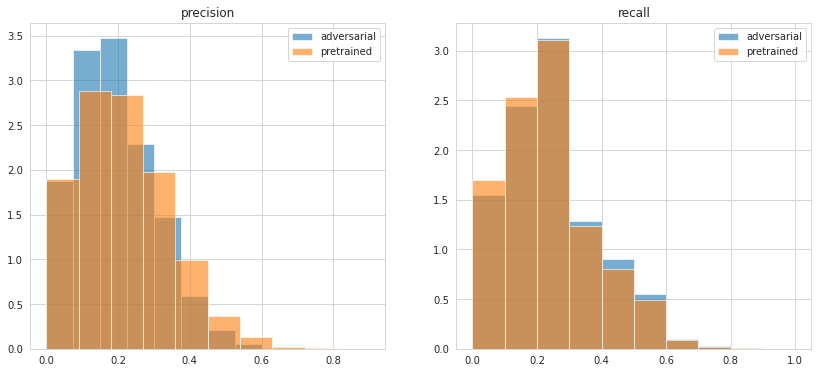

"\nplt.subplot(1, 3, 3)\nplt.title('fmeasure')\nplt.hist(fscores1, label=f'adversarial', alpha=0.6, density=True)\nplt.hist(fscores2, label=f'pretrained', alpha=0.6, density=True)\nplt.legend()\nplt.show()\nplt.show()\n"

In [69]:
plt.figure(figsize=(14,6))

plt.subplot(1, 2, 1)
plt.title('precision')
plt.hist(precisions1, label=f'adversarial', alpha=0.6, density=True)
plt.hist(precisions2, label=f'pretrained', alpha=0.6, density=True)
plt.legend()

plt.subplot(1, 2, 2)
plt.title('recall')
plt.hist(recalls1, label=f'adversarial', alpha=0.6, density=True)
plt.hist(recalls2, label=f'pretrained', alpha=0.6, density=True)
plt.legend()
plt.show()
'''
plt.subplot(1, 3, 3)
plt.title('fmeasure')
plt.hist(fscores1, label=f'adversarial', alpha=0.6, density=True)
plt.hist(fscores2, label=f'pretrained', alpha=0.6, density=True)
plt.legend()
plt.show()
plt.show()
'''

In [302]:
ind = 66
m = attn_matrix(attentions, ind=ind)

tokens = preds.permute(1, 0).detach().cpu().numpy().tolist()
tokens = list(map(lambda x: [int(c) for c in x], tokens))[ind]
pred_words = [sp.decode(token) for token in tokens][1:]

tokens = article.permute(1, 0).detach().cpu().numpy().tolist()
tokens = list(map(lambda x: [int(c) for c in x], tokens))[ind]
article_words = [sp.decode(token) for token in tokens]

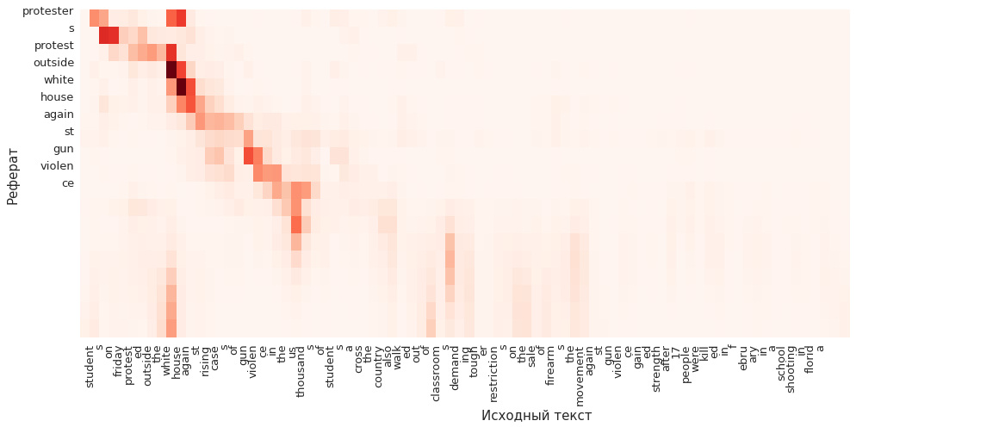

In [306]:
y_min = 0
y_max = 20
x_min = 0
x_max = 80

m = m[y_min:y_max, x_min:x_max]
plt.figure(figsize=(19, 7))
sns.heatmap(m, cbar=False, cmap='Reds')
# g.set(xticks=article_words)
plt.yticks(range(0, len(pred_words)), pred_words, rotation=0, fontsize=13)
plt.xticks(range(0,len(article_words)), article_words, rotation=90, fontsize=13)
plt.xlabel('Исходный текст', fontsize=15)
plt.ylabel('Реферат', fontsize=15)
plt.show()

### 8. LDA visualization

In [12]:
len(articles_val_topics)

29521

In [18]:
%%time
tsne_model = TSNE(n_components=2, verbose=1, random_state=0, angle=.99, init='pca')
df = np.array(articles_val_topics)
transformed = tsne_model.fit_transform(df)

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 29521 samples in 0.020s...
[t-SNE] Computed neighbors for 29521 samples in 2.897s...
[t-SNE] Computed conditional probabilities for sample 1000 / 29521
[t-SNE] Computed conditional probabilities for sample 2000 / 29521
[t-SNE] Computed conditional probabilities for sample 3000 / 29521
[t-SNE] Computed conditional probabilities for sample 4000 / 29521
[t-SNE] Computed conditional probabilities for sample 5000 / 29521
[t-SNE] Computed conditional probabilities for sample 6000 / 29521
[t-SNE] Computed conditional probabilities for sample 7000 / 29521
[t-SNE] Computed conditional probabilities for sample 8000 / 29521
[t-SNE] Computed conditional probabilities for sample 9000 / 29521
[t-SNE] Computed conditional probabilities for sample 10000 / 29521
[t-SNE] Computed conditional probabilities for sample 11000 / 29521
[t-SNE] Computed conditional probabilities for sample 12000 / 29521
[t-SNE] Computed conditional probabilities for sam

In [22]:
val_topics = [np.argmax(topic_vector) for topic_vector in articles_val_topics]

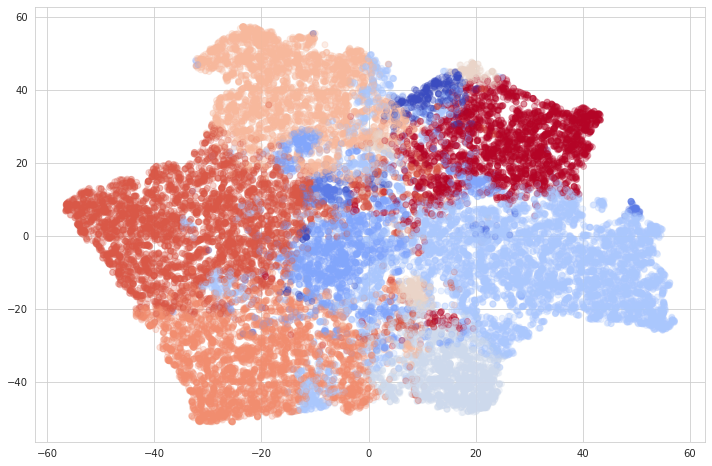

In [57]:
plt.figure(figsize=(12,8))
plt.scatter(transformed[:, 0], transformed[:, 1], c=val_topics, alpha=0.25, cmap='coolwarm')
plt.show()

In [55]:
mycolors = np.array([color for name, color in mcolors.TABLEAU_COLORS.items()])

In [23]:
for i in range(transformed.shape[0]):
    

(29521, 2)

In [53]:
val_articles

array(['students in karnataka will get extra marks if their parents cast votes in the upcoming assembly elections  the associated management of primary and secondary schools has announced  the  encouraging marks  will be added in the 2018 19 academic year  the association said   after casting their votes  parents can visit member schools   and confirm that they voted by showing the indelible ink mark  ',
       'syrian anti aircraft defences on monday shot down missiles over two air bases  syria s state media said  the missiles targeted shayrat air base in the homs province and another base northeast of the capital damascus  this comes days after the us  uk and france launched air strikes on syrian chemical weapons facilities in retaliation for the alleged chemical attack in douma ',
       'a dinosaur like creature s fossil was found during an excavation on sunday in uttarakhand s jaspur  a small city 110 km from nainital  the fossil s hind legs measure around 29 cm while the tail is 